# Libraries, figure parameters and custom functions

In [1]:
import scanpy as sc
import numpy as np
import pandas as pd
import anndata as ann
import seaborn as sns
import matplotlib.pyplot as plt
from matplotlib import colors
from matplotlib import rcParams

import os
#import custom_functions as cf

In [2]:
sc.logging.print_versions()

-----
anndata     0.7.5
scanpy      1.6.0
sinfo       0.3.1
-----
PIL                 8.0.1
anndata             0.7.5
backcall            0.2.0
cairo               1.20.0
cffi                1.14.4
cloudpickle         1.6.0
colorama            0.4.4
cycler              0.10.0
cython_runtime      NA
cytoolz             0.11.0
dask                2021.01.1
dateutil            2.8.1
decorator           4.4.2
get_version         2.1
h5py                3.1.0
igraph              0.8.3
ipykernel           5.3.4
ipython_genutils    0.2.0
jedi                0.17.0
joblib              1.0.0
kiwisolver          1.3.1
legacy_api_wrap     0.0.0
leidenalg           0.8.3
llvmlite            0.35.0
matplotlib          3.3.3
mpl_toolkits        NA
natsort             7.1.0
numba               0.52.0
numexpr             2.7.1
numpy               1.19.4
packaging           20.8
pandas              1.1.5
parso               0.8.1
pexpect             4.8.0
pickleshare         0.7.5
pkg_resources       N

Add date.

In [3]:
from datetime import date

In [4]:
today = date.today().strftime("%y%m%d")

Add my color scheme.

In [5]:
colors2 = plt.cm.RdYlBu_r(np.linspace(0, 1, 128))
colors3 = plt.cm.Greys_r(0.7)
colorsComb = np.vstack([colors3, colors2])
mymap = colors.LinearSegmentedColormap.from_list('my_colormap', colorsComb)

Set parameters for plots in scanpy

In [6]:
sc.settings.set_figure_params(dpi=80)

sc.set_figure_params(scanpy=True, dpi=80, dpi_save=250,
                     frameon=True, vector_friendly=True,
                     color_map='viridis', format='pdf', transparent=False,
                     ipython_format='png2x')

In [7]:
def cell_compo_table(adata, cluster, condition, xlabel='cell cluster',
                        ylabel='cell count', title=None, save=False):
    """
    """
    

    contingency_table = pd.crosstab(
        adata.obs[condition],
        adata.obs[cluster],
        margins = True
    )
    return(contingency_table)

def top_marker_as_xlsx(adata, key_rank_genes, key_groups, output_file):
    
    print(adata.uns[key_rank_genes].keys())
    dict_genes = adata.uns[key_rank_genes].copy()
    print(dict_genes['params'])
    del dict_genes['params']
    clusters = sorted(list(set(adata.obs[key_groups])))*len(dict_genes['scores'])
    for key, value in dict_genes.items():
        tmp_list = []
        for n in value:
            tmp_list = tmp_list + list(n)
        dict_genes[key] = tmp_list
    
    dict_genes['cluster'] = clusters

    dataframe = pd.DataFrame(dict_genes)
    dataframe.to_excel(output_file)
    return(dataframe)

# Load data

In [8]:
project_dir = '/storage/groups/ml01/workspace/maren.buettner/Martinez_Liver_HPC/'

In [9]:
data_dir = project_dir + 'data/'

In [10]:
adata = sc.read(data_dir + 'snRNAseq_mouse_hepatocytes_all_cells_filtered_TPM_mar21.h5ad')

Use the wild type cells as reference for the knock-out cell annotation.

In [11]:
adata_wt_young = sc.read(data_dir + 'snRNAseq_mouse_hepatocytes_young_cells_filtered_TPM_jul21_annotated.h5ad')
adata_wt_old = sc.read(data_dir + 'snRNAseq_mouse_hepatocytes_old_cells_filtered_TPM_jul21_annotated.h5ad')

In [12]:
adata_wt = adata_wt_young.concatenate(adata_wt_old, index_unique=None)

Merge the wild type annotation with the unannotated cells. 

In [13]:
adata.obs['cell_type'] = adata_wt.obs['cell_type'].cat.add_categories('not annotated')
adata.obs['cell_type1'] = adata_wt.obs['cell_type1'].cat.add_categories('not annotated')

In [14]:
adata.obs['cell_type'].fillna("not annotated", inplace=True)
adata.obs['cell_type1'].fillna("not annotated", inplace=True)

In [18]:
adata.obs['cell_type'] = adata.obs['cell_type'].cat.remove_unused_categories()
adata.obs['cell_type1'] = adata.obs['cell_type1'].cat.remove_unused_categories()

## Marker gene expression for cell type annotation

We load the list of marker genes per cell type and plot them as tSNE. In the second step, we use the gene list to compute gene set scores.

In [15]:
marker_cell = pd.read_csv(data_dir + "Cell_type_markers_curated_KY_MB_201009.csv", sep=';')

In [16]:
marker_names_all = marker_cell['Gene name'].values
cell_type_list = marker_cell['Cell type'].values
   
cell_type_dict = {}
for name in list(set(cell_type_list)):
    cell_type_dict[name] = []
for i in range(0, len(cell_type_list)):
    cell_type_dict[cell_type_list[i]].append(marker_names_all[i])
gene_name_dict = {}
for i in range(0, len(adata.var)):
    gene_name_dict[adata.var["gene_name"][i]] = adata.var_names[i]
cell_type_id_dict = {}
for name in list(set(cell_type_list)):
    cell_type_id_dict[name] = []
cell_type_name_dict = {}
for name in list(set(cell_type_list)):
    cell_type_name_dict[name] = []
for name in list(set(cell_type_list)):
    item = cell_type_dict[name]
    for elem in item:
        if elem in gene_name_dict.keys():
            cell_type_id_dict[name].append(gene_name_dict[elem])
            cell_type_name_dict[name].append(elem) 

# Cell type identification

In the following, we will annotate the knock-out mice per age group and per strain. Specifically, we use a label transfer via joint embedding and clustering of wild type and knock-out cells.

## Young mice only

In [19]:
adata_young = adata[adata.obs['age_grouped']=='young'].copy()

/home/icb/maren.buettner/anaconda3/envs/sc-tutorial/lib/python3.8/site-packages/anndata/_core/anndata.py:1094: FutureWarning: is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead
  if not is_categorical(df_full[k]):


### Select CEBPA knock-out

In [20]:
adata_young.obs['strain'].value_counts()

C57Bl6/J    1733
CEBPA KO     828
HNF4 KO      518
CTCF KO      495
Name: strain, dtype: int64

Select CEBPA knock-out and wild type cells.

In [11]:
ko_prefix = 'CEBPA-KO'
strain = 'CEBPA KO'

In [22]:
adata_young = adata_young[np.in1d(adata_young.obs['strain'], [strain, 'C57Bl6/J'])]

In [23]:
adata_young

View of AnnData object with n_obs × n_vars = 2561 × 30520
    obs: 'batch', 'exp.', 'libraryID', 'experiment', 'strain', 'age', 'sex', 'ploidy', 'ERCC.dilution', 'column', 'row', 'percentERCC', 'n_counts', 'age_grouped', 'n_counts_raw', 'n_counts_transcripts', 'n_counts_ERCC', 'n_genes', 'high_ERCC', 'low_ERCC', 'low_genes', 'high_genes', 'low_counts', 'high_counts', 'ERCC_size_factor', 'n_counts_TPM', 'RPK_factor', 'n_counts_TPM_norm', 'mean_transcript_count_TPM', 'cyclone_phases', 'score_G1', 'score_S', 'score_G2M', 'cell_type', 'cell_type1'
    var: 'length', 'gene_name', 'chromosomes', 'start', 'end', 'n_counts', 'mean_exp_TPM', 'median_exp_TPM'
    uns: 'ERCC.dilution_colors', 'age_colors', 'age_grouped_colors', 'cyclone_phases_colors', 'exp._colors', 'neighbors', 'pca', 'ploidy_colors', 'strain_colors', 'umap'
    obsm: 'X_pca', 'X_tsne', 'X_umap'
    varm: 'PCs'
    layers: 'counts', 'norm_counts', 'raw', 'raw_bin'
    obsp: 'connectivities', 'distances'

In [24]:
sc.pp.pca(adata_young, svd_solver='arpack')
sc.pp.neighbors(adata_young)

In [25]:
sc.tl.tsne(adata_young, perplexity=40, n_pcs=15)

/home/icb/maren.buettner/anaconda3/envs/sc-tutorial/lib/python3.8/site-packages/anndata/_core/anndata.py:1192: FutureWarning: is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead
  if is_string_dtype(df[key]) and not is_categorical(df[key])


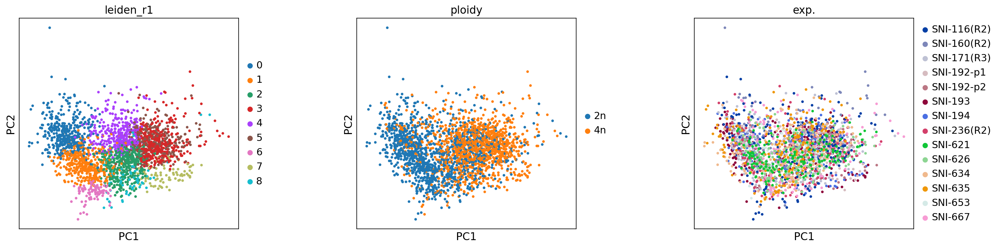

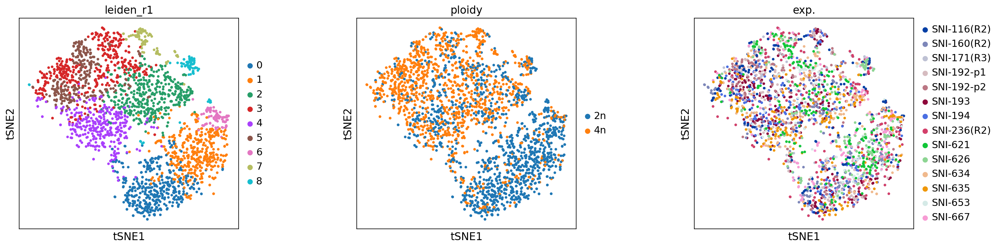

In [26]:
rcParams['figure.figsize']=(5,5)
sc.tl.leiden(adata_young, resolution=1, key_added='leiden_r1')
sc.pl.pca(adata_young, wspace=0.4, color=["leiden_r1", "ploidy","exp."])
sc.pl.tsne(adata_young, wspace=0.4, color=["leiden_r1", "ploidy","exp."])

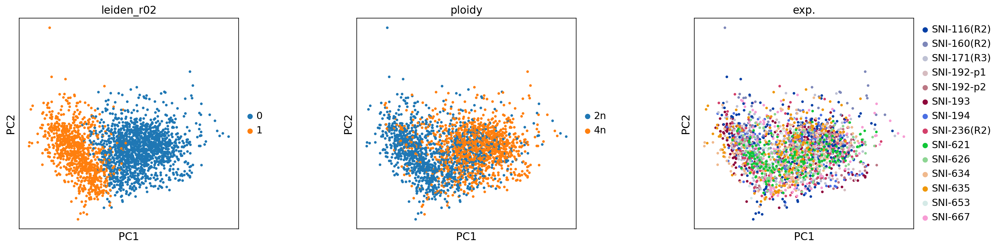

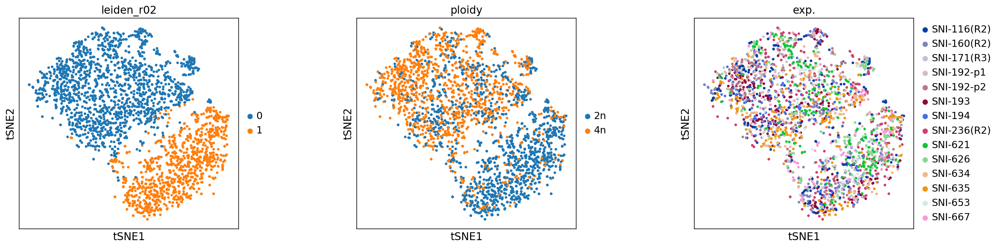

In [27]:
# low resolution louvain clustering to separate hepatocytes from non-parenchymal cells
sc.tl.leiden(adata_young, resolution=0.2, key_added='leiden_r02')
sc.pl.pca(adata_young, wspace=0.4, color=["leiden_r02", "ploidy","exp."])
sc.pl.tsne(adata_young, wspace=0.4, color=["leiden_r02", "ploidy","exp."])

In [28]:
adata_young.obs['low_res_ct'] = adata_young.obs['leiden_r02']

Label 4n cells that are in the non-parenchymal cluster.

In [29]:
adata_young.obs['clusters'] = "2-2n"
adata_young.obs['clusters'].loc[np.logical_and(adata_young.obs['low_res_ct']=='0', 
                                         adata_young.obs['ploidy']=='2n')] = "2n_hepatocytes"
adata_young.obs['clusters'].loc[np.logical_and(adata_young.obs['low_res_ct']=='0', 
                                         adata_young.obs['ploidy']=='4n')] = "4n_hepatocytes"
adata_young.obs['clusters'].loc[np.logical_and(adata_young.obs['low_res_ct']=='1', 
                                         adata_young.obs['ploidy']=='2n')] = "2n_other_cluster"
adata_young.obs['clusters'].loc[np.logical_and(adata_young.obs['low_res_ct']=='1', 
                                         adata_young.obs['ploidy']=='4n')] = "4n_other_cluster"
adata_young.obs['clusters'] = adata_young.obs['clusters'].astype('category')

/home/icb/maren.buettner/anaconda3/envs/sc-tutorial/lib/python3.8/site-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)


In [30]:
adata_young.obs['clusters'].value_counts()

4n_hepatocytes      1094
2n_other_cluster     827
2n_hepatocytes       504
4n_other_cluster     136
Name: clusters, dtype: int64

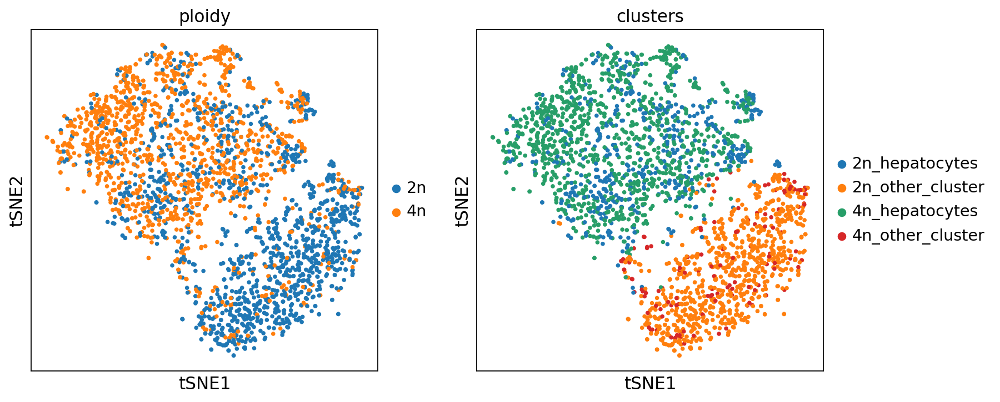

In [31]:
sc.pl.tsne(adata_young, color=['ploidy', 'clusters'])

Compute a gene set score for every gene set.

In [32]:
for key in cell_type_id_dict.keys():
    sc.tl.score_genes(adata_young, cell_type_id_dict[key], score_name='score_' + key, use_raw=True)

/home/icb/maren.buettner/anaconda3/envs/sc-tutorial/lib/python3.8/site-packages/anndata/_core/anndata.py:1192: FutureWarning: is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead
  if is_string_dtype(df[key]) and not is_categorical(df[key])


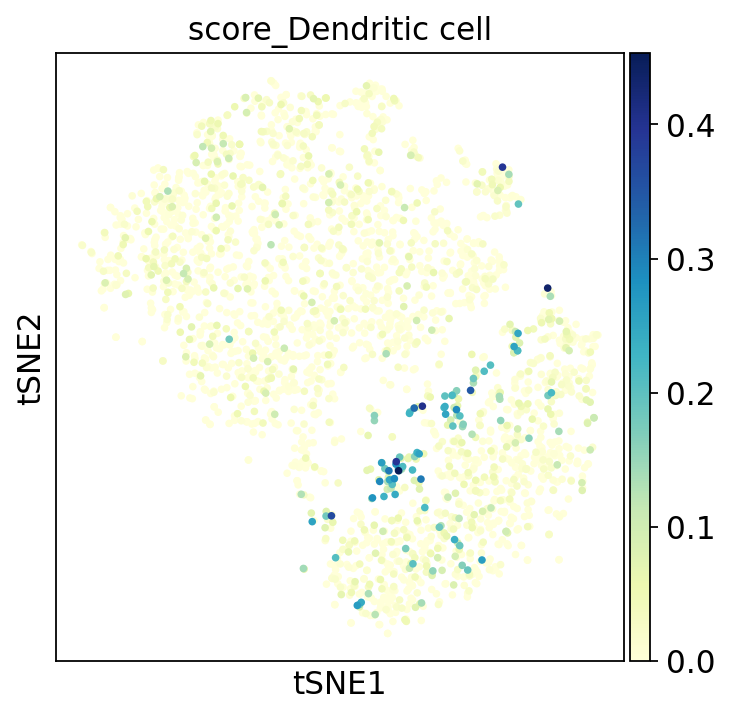

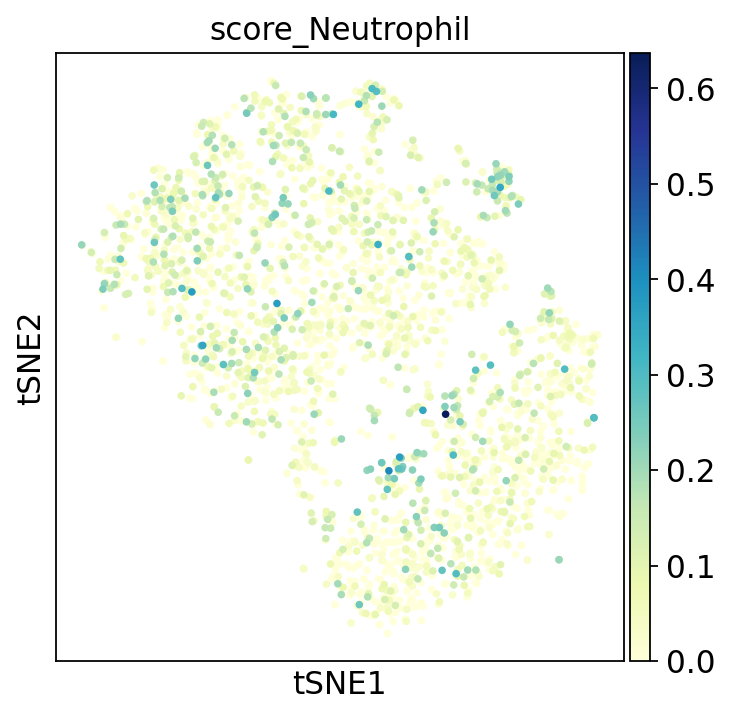

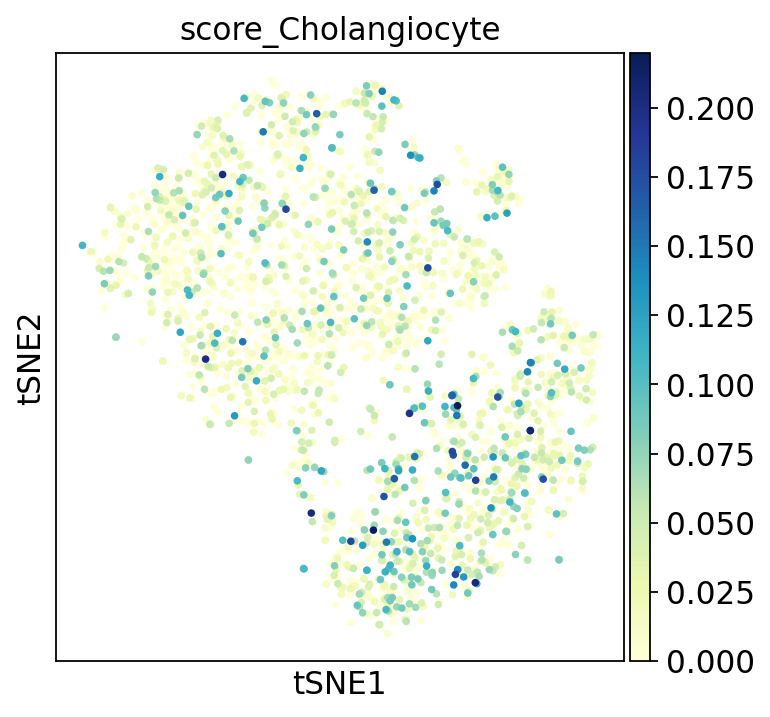

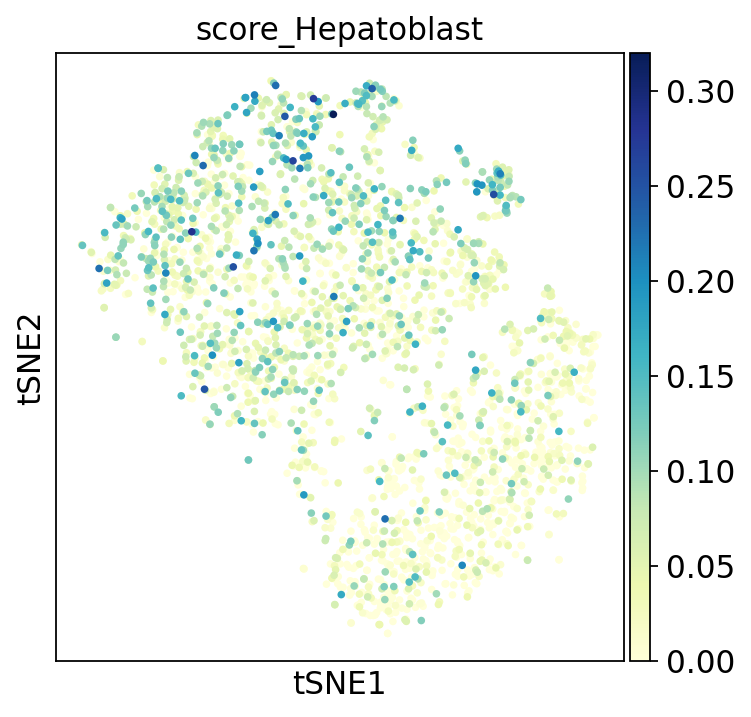

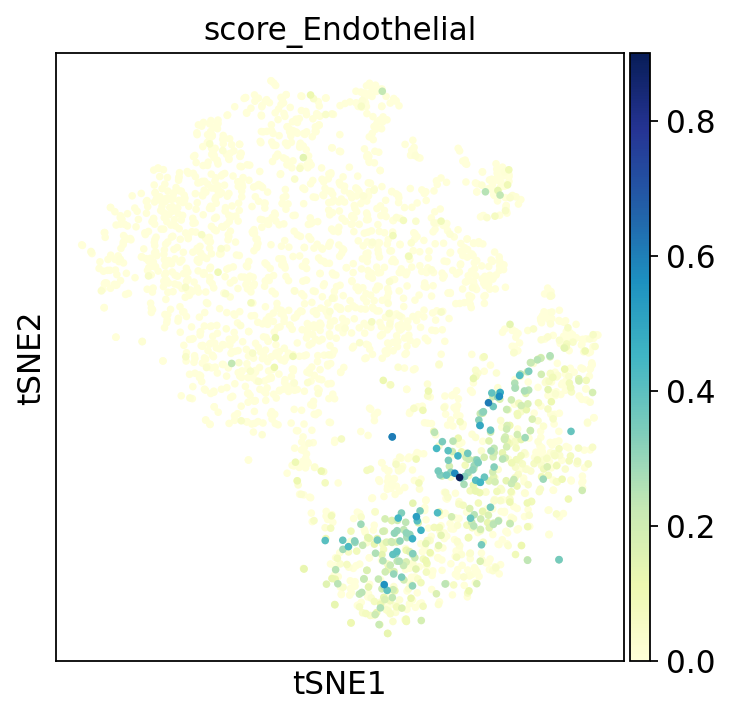

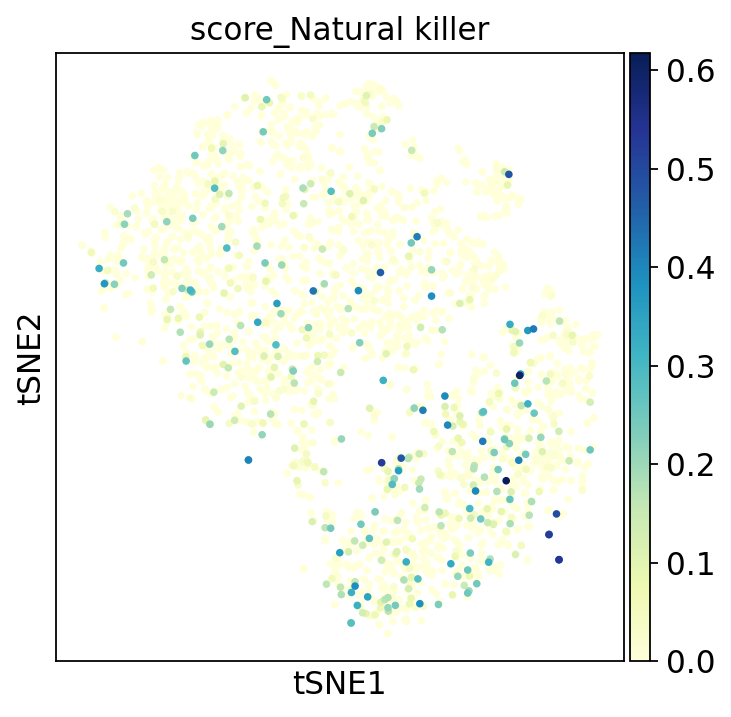

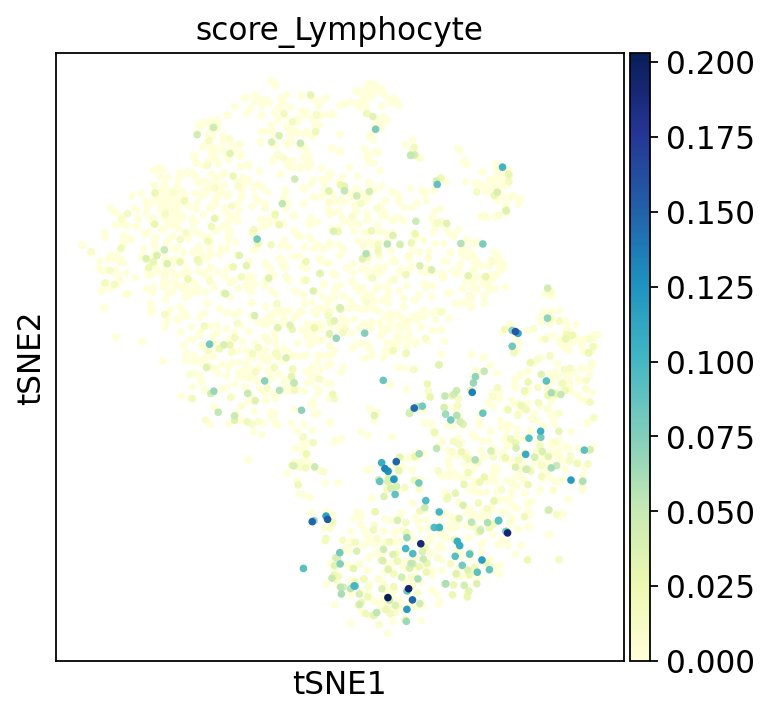

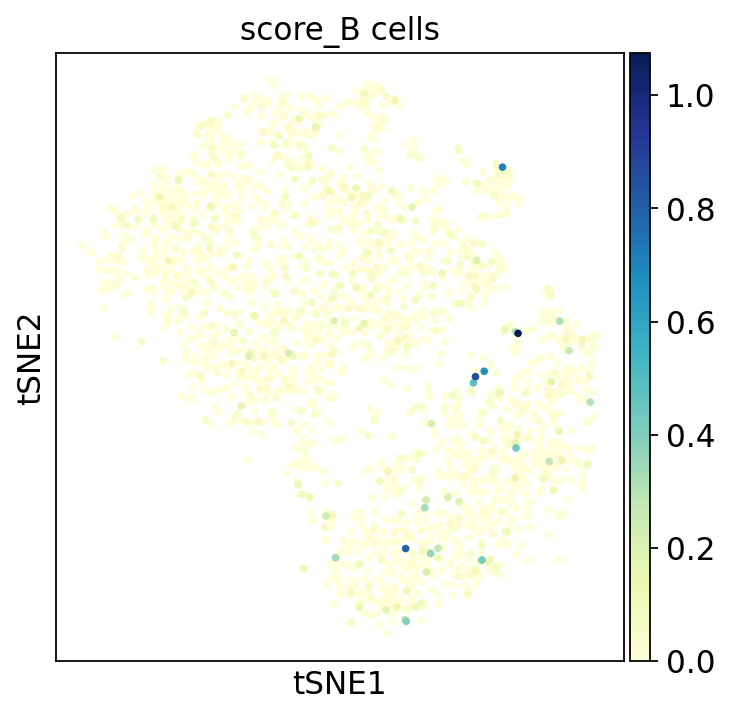

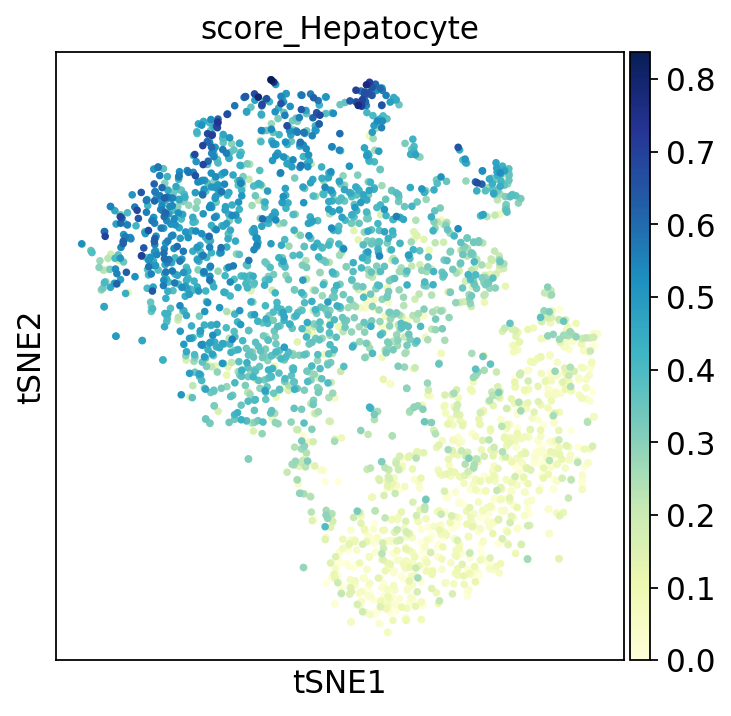

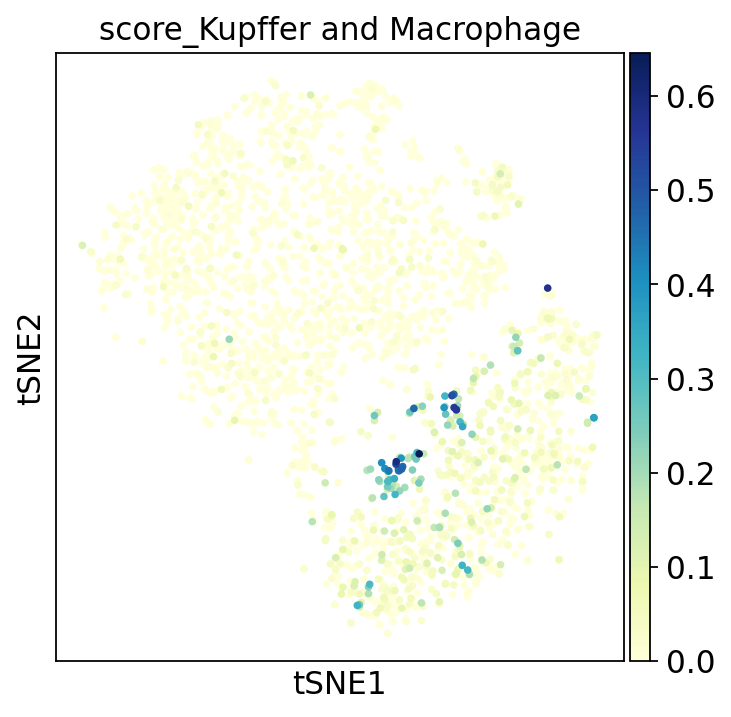

In [33]:
rcParams['figure.figsize']=(5,5)
for key in cell_type_id_dict.keys():
    sc.pl.tsne(adata_young, color='score_' + key, cmap='YlGnBu', vmin=0)

In [34]:
rcParams['figure.figsize']=(5,5)
# high resolution clustering for the non-parenchymal cells
sc.tl.leiden(adata_young, resolution=2, key_added='leidenr02_02', restrict_to=['leiden_r02', ['1']])
#sc.tl.louvain(adata, resolution=0.75, key_added='louvainr02_02', restrict_to=['louvainr02_02', ['1,0']])
#sc.tl.louvain(adata, resolution=0.5, key_added='louvainr02_02', restrict_to=['louvainr02_02', ['0']])
#sc.tl.louvain(adata, resolution=0.75, key_added='louvainr02_02', restrict_to=['louvainr02_02', ['0,2']])

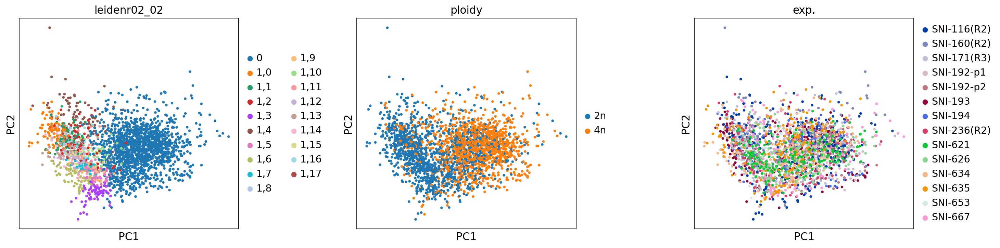

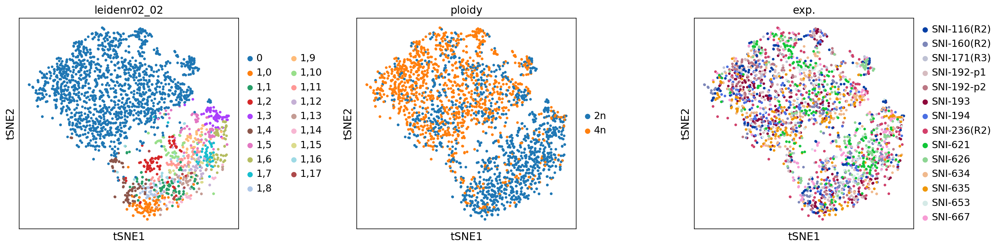

In [35]:
rcParams['figure.figsize']=(5,5)
sc.pl.pca(adata_young, wspace=0.4, color=["leidenr02_02", "ploidy","exp."])
sc.pl.tsne(adata_young, wspace=0.4, color=["leidenr02_02", "ploidy","exp."])

In [36]:
pd.crosstab(adata_young.obs['cell_type'], adata_young.obs['leidenr02_02'])

leidenr02_02,0,"1,0","1,1","1,2","1,3","1,4","1,5","1,6","1,7","1,8","1,9","1,10","1,11","1,12","1,13","1,14","1,15","1,16","1,17"
cell_type,,,,,,,,,,,,,,,,,,,
2n Hepatocytes,321,0,0,0,0,7,3,1,1,0,0,3,0,0,0,0,0,0,0
4n Hepatocytes,781,0,0,1,0,6,6,0,0,0,0,1,0,0,0,0,0,0,0
Hepatobiliary cells,37,0,0,0,38,0,24,6,3,0,10,2,1,0,0,0,0,0,0
Endothelial cells,0,22,3,0,0,5,0,0,0,40,1,11,1,1,15,3,0,0,0
Kupffer and Dendritic cells,0,0,2,51,0,3,1,0,0,0,0,0,0,0,0,0,0,0,0
Lymphocytes,2,60,50,6,0,31,1,29,27,2,0,6,3,8,15,17,11,15,2
Stellate cells,0,0,7,0,0,0,0,0,0,1,6,0,18,4,0,0,1,0,0
not annotated,457,19,23,22,36,22,33,24,26,9,33,26,24,32,12,4,10,4,12


Make a rough annotation based on a majority vote with the wild type cells.

In [37]:

adata_young.obs["cell_type"].loc[np.logical_and(adata_young.obs['cell_type']=='not annotated',
                                                np.in1d(adata_young.obs["leidenr02_02"], 
                                         ['1,3', '1,5', '1,9']))] = 'Hepatobiliary cells'
adata_young.obs["cell_type"].loc[np.logical_and(adata_young.obs['cell_type']=='not annotated',
                                                np.in1d(adata_young.obs["leidenr02_02"], 
                                         ['1,2']))] = 'Kupffer and Dendritic cells'
adata_young.obs["cell_type"].loc[np.logical_and(adata_young.obs['cell_type']=='not annotated',
                                                np.in1d(adata_young.obs["leidenr02_02"], 
                                         ['1,11']))] = 'Stellate cells' 
adata_young.obs["cell_type"].loc[np.logical_and(adata_young.obs['cell_type']=='not annotated',
                                                np.in1d(adata_young.obs["leidenr02_02"], 
                                         ['1,8', '1,10','1,13']))] = 'Endothelial cells'
adata_young.obs["cell_type"].loc[np.logical_and(adata_young.obs['cell_type']=='not annotated',
                                                np.in1d(adata_young.obs["leidenr02_02"], 
                                         ['1,0','1,1','1,4', '1,6', '1,7', '1,12', '1,14', '1,15', '1,16','1,17']))] = 'Lymphocytes'


adata_young.obs["cell_type"][adata_young.obs["clusters"]=='2n_hepatocytes'] = '2n Hepatocytes'
adata_young.obs["cell_type"][adata_young.obs["clusters"]=='4n_hepatocytes'] = '4n Hepatocytes'

adata_young.obs['cell_type'] = adata_young.obs['cell_type'].cat.remove_unused_categories() 


In [39]:
adata_young.obs['cell_type'].value_counts()

4n Hepatocytes                 1108
2n Hepatocytes                  519
Lymphocytes                     459
Hepatobiliary cells             186
Endothelial cells               149
Kupffer and Dendritic cells      79
Stellate cells                   61
Name: cell_type, dtype: int64

In [40]:
adata_young.obs['cell_type'].value_counts(normalize=True)

4n Hepatocytes                 0.432643
2n Hepatocytes                 0.202655
Lymphocytes                    0.179227
Hepatobiliary cells            0.072628
Endothelial cells              0.058180
Kupffer and Dendritic cells    0.030847
Stellate cells                 0.023819
Name: cell_type, dtype: float64

Set cell type colors.

In [41]:
adata_young.uns["cell_type_colors"] = ["#1f77b4", "#ff7f0e",
                                       #"#332288", "#332288", #Hepatocyte color
                                       "#8c564b",
                                       "#DC050C","#FFAABB","#ade8e3","#17becf"]

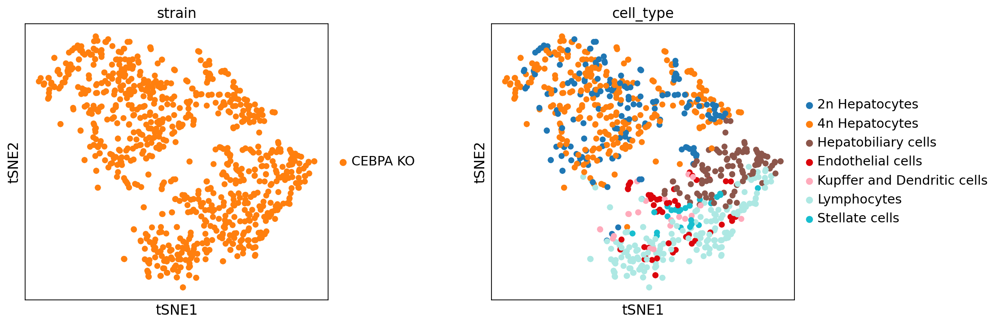

In [23]:
rcParams['figure.figsize']=(5,5)
sc.pl.tsne(adata_young, wspace=0.4, color=["strain", "cell_type"])

In [26]:
rcParams['figure.figsize']=(10,5)
for key in cell_type_id_dict.keys():
    sc.pl.violin(adata_young, keys='score_' + key, groupby='cell_type', rotation=90)

NameError: name 'cell_type_id_dict' is not defined

Take only knock-out cells and re-compute embedding.

In [44]:
adata_young = adata_young[adata_young.obs['strain']==strain]

/home/icb/maren.buettner/anaconda3/envs/sc-tutorial/lib/python3.8/site-packages/anndata/_core/anndata.py:1094: FutureWarning: is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead
  if not is_categorical(df_full[k]):


In [45]:
sc.pp.pca(adata_young, svd_solver='arpack')
sc.pp.neighbors(adata_young)
sc.tl.tsne(adata_young, perplexity=30, n_pcs=10)

In [46]:
chol_markers = ['Sptbn1','Sox9','Sox4','Kit','Slc22a3',
                'Hnf1b','Erbb3','Fgfr2','Fgfr3','Sorl1','Wwc1',
                'Cftr','Pkd2','Pkhd1l1','Lrp2','Cdh11','Igfbp5','Wt1','Igfbp6',
                'Wnt2b','Bmp4','Sulf2','Gas1','Gpc3','Vim','Fgf1','Onecut1',
                'Klra2','Ccl5','Pla2g7','Clec12a','Itgal','Folr2','Cybb','Cd38',
                'Epcam','Cdh1']

hepatoblast_markers = ["Ncam1","Cd44","Dlk1","Icam1","Epcam","Cdh1","Onecut3","Afp","Agt","Fgg",
                       "Gsta1","Id3","Lin28b","Etv5","Lgr5","Tbx3","Foxm1","Kit",
                      "Onecut1","Onecut2","Notch2","Tbx3","Hnf1b","Hes1","Foxa2","Foxa3","Hhex",
                       "Sall4","Hnf4a","Alb","Krt19","Epcam","Tacstd2","Anpep","Itga6","Cd133",
                       "Thy1","Fgf7","Sox9","Krt18","Krt19","Cebpa","Serpina16","Mki67","Krt7",
                       "Tmem45b","Tacstd2","Igdcc4","Itga6","Ptprcap","Atxn1"]

nmarker_name = {}
nmarker_id = []
index = 0
for n in adata.var["gene_name"].tolist():
    if n in hepatoblast_markers:
        nmarker_name[n] = adata_young.var_names[index]
        nmarker_id.append(adata_young.var_names[index])
    index += 1

adatah = adata_young[:,nmarker_id].copy()

/home/icb/maren.buettner/anaconda3/envs/sc-tutorial/lib/python3.8/site-packages/anndata/_core/anndata.py:1094: FutureWarning: is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead
  if not is_categorical(df_full[k]):


In [47]:
adata_young.obs["hblast_marker_sum"] = np.sum(adatah.layers["raw"], axis=1)

Color the clusters nicely

In [48]:
adata_young.uns["low_res_ct_colors"] = ["#686868", "#a9a9a9"]

Combine the hepatocytes and re-arrange the levels.

In [49]:
adata_young.obs['cell_type1'] = adata_young.obs['cell_type'].cat.add_categories(['Hepatocytes'])
adata_young.obs['cell_type1'][np.in1d(adata_young.obs['cell_type'], 
                                      ["2n Hepatocytes", "4n Hepatocytes"])] = 'Hepatocytes'
adata_young.obs['cell_type1'] = adata_young.obs['cell_type1'].cat.remove_unused_categories()
adata_young.obs['cell_type1'] = adata_young.obs['cell_type1'].cat.reorder_categories(['Hepatocytes', 
                                              'Hepatobiliary cells', 'Endothelial cells', 
                                     "Kupffer and Dendritic cells", 'Lymphocytes','Stellate cells'
                                               
                                                                         ])

In [50]:
adata_young.uns["cell_type1_colors"] = ["#332288", #Hepatocyte color
                                       "#8c564b",
                                       "#DC050C","#FFAABB","#ade8e3","#17becf"]

/home/icb/maren.buettner/anaconda3/envs/sc-tutorial/lib/python3.8/site-packages/anndata/_core/anndata.py:1192: FutureWarning: is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead
  if is_string_dtype(df[key]) and not is_categorical(df[key])


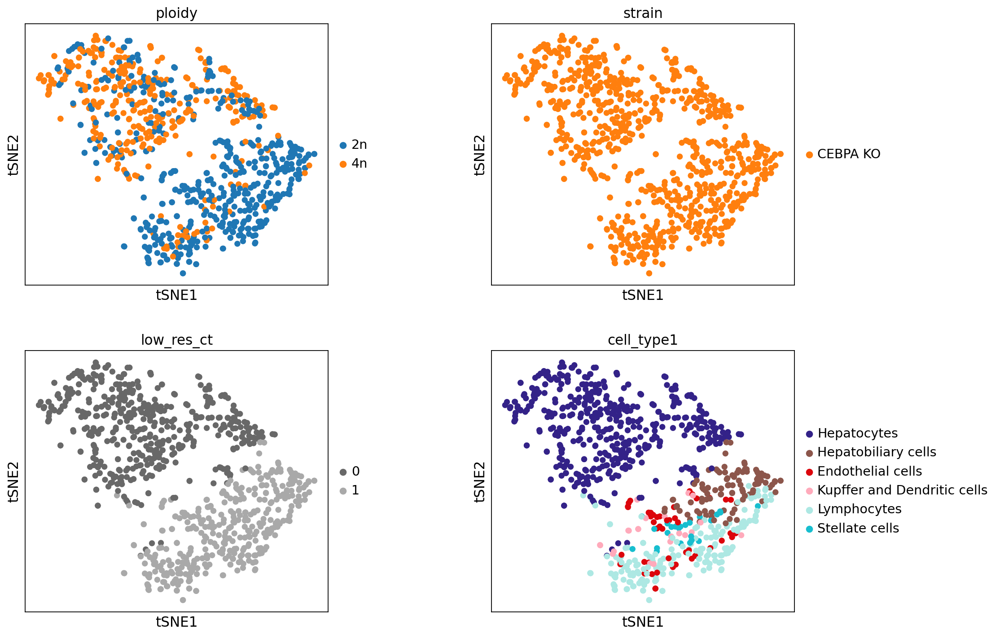

In [52]:
rcParams['figure.figsize']=(5,5)
sc.pl.tsne(adata_young, color=["ploidy", "strain", "low_res_ct", "cell_type1"],
           ncols=2, wspace=0.4, save="_" + today + "_young_"+ ko_prefix+"_prelim_annotation.pdf")

Save the annotated `adata` file.

In [53]:
adata_young.write(data_dir + 'snRNAseq_mouse_hepatocytes_young_'+ ko_prefix +'_filtered_TPM_jul21_annotated.h5ad')

/home/icb/maren.buettner/anaconda3/envs/sc-tutorial/lib/python3.8/site-packages/anndata/_core/anndata.py:1192: FutureWarning: is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead
  if is_string_dtype(df[key]) and not is_categorical(df[key])


In [12]:
adata_young = sc.read(data_dir + 'snRNAseq_mouse_hepatocytes_young_'+ ko_prefix +'_filtered_TPM_jul21_annotated.h5ad')

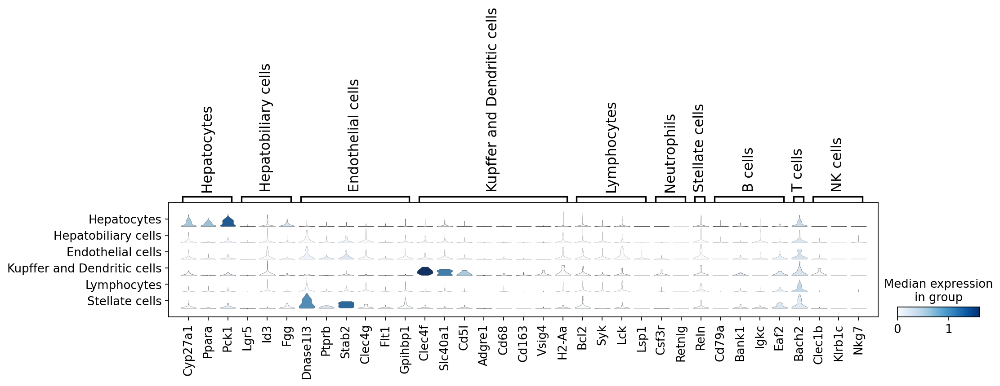

In [13]:
# plotting the markers nicely (using scanpy 1.6)


small_marker_dict = {"Hepatocytes":["Cyp27a1","Ppara","Pck1"],
                    "Hepatobiliary cells":["Lgr5","Id3","Fgg"],
                    "Endothelial cells":["Dnase1l3","Ptprb","Stab2", "Clec4g", "Flt1","Gpihbp1"],
                    "Kupffer and Dendritic cells":["Clec4f","Slc40a1","Cd5l", "Adgre1",  
                                                   "Cd68", "Cd163", "Vsig4", "H2-Aa"],
                    "Lymphocytes":["Bcl2","Syk","Lck", 'Lsp1'],
                     "Neutrophils":["Csf3r", "Retnlg"],
                     'Stellate cells': ['Reln'],
                    "B cells": ["Cd79a", "Bank1", "Igkc", 'Eaf2'],
                     "T cells": ["Bach2"],
                    "NK cells": ["Clec1b", "Klrb1c", "Nkg7"]}

sc.pl.stacked_violin(adata_young, gene_symbols="gene_name", groupby="cell_type1", 
                     var_names=small_marker_dict, save='_'+today+"_young_" + ko_prefix+ "_prelim_annotation_markers.pdf")

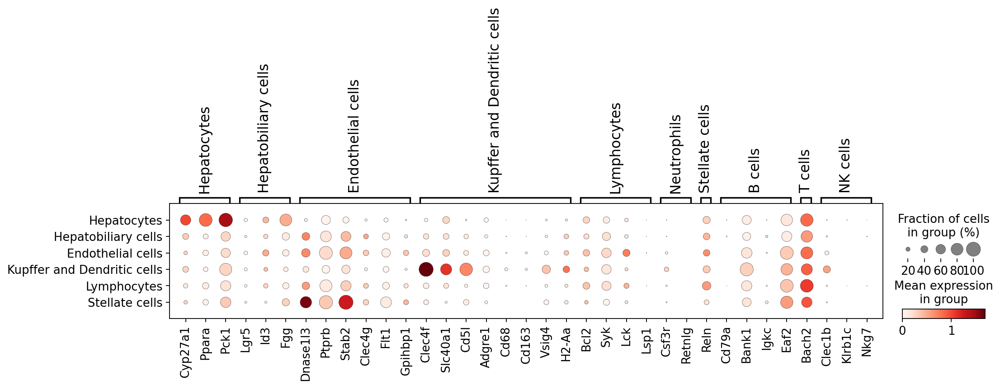

In [14]:
sc.pl.dotplot(adata_young, gene_symbols="gene_name", groupby="cell_type1", 
                     var_names=small_marker_dict, save='_'+today+"_young_" + ko_prefix+ "_prelim_annotation_markers.pdf")

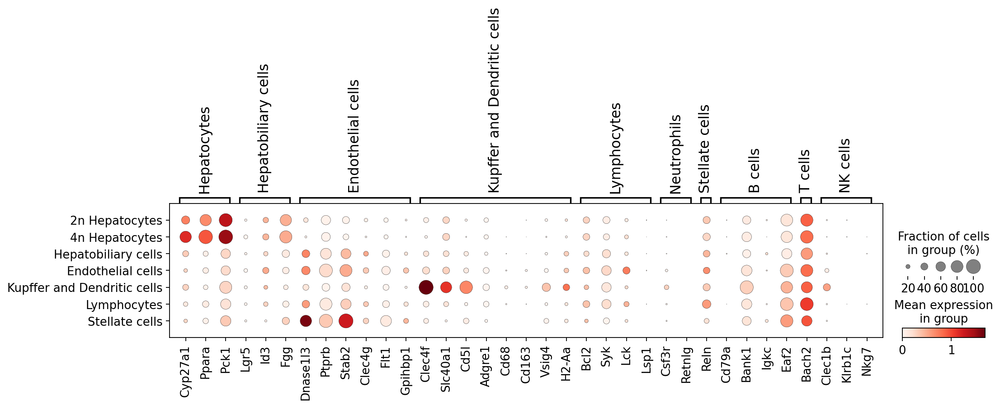

In [15]:
sc.pl.dotplot(adata_young, gene_symbols="gene_name", groupby="cell_type", 
                     var_names=small_marker_dict, save='_'+today+"_young_" + ko_prefix+ "_prelim_annotation_markers2.pdf")

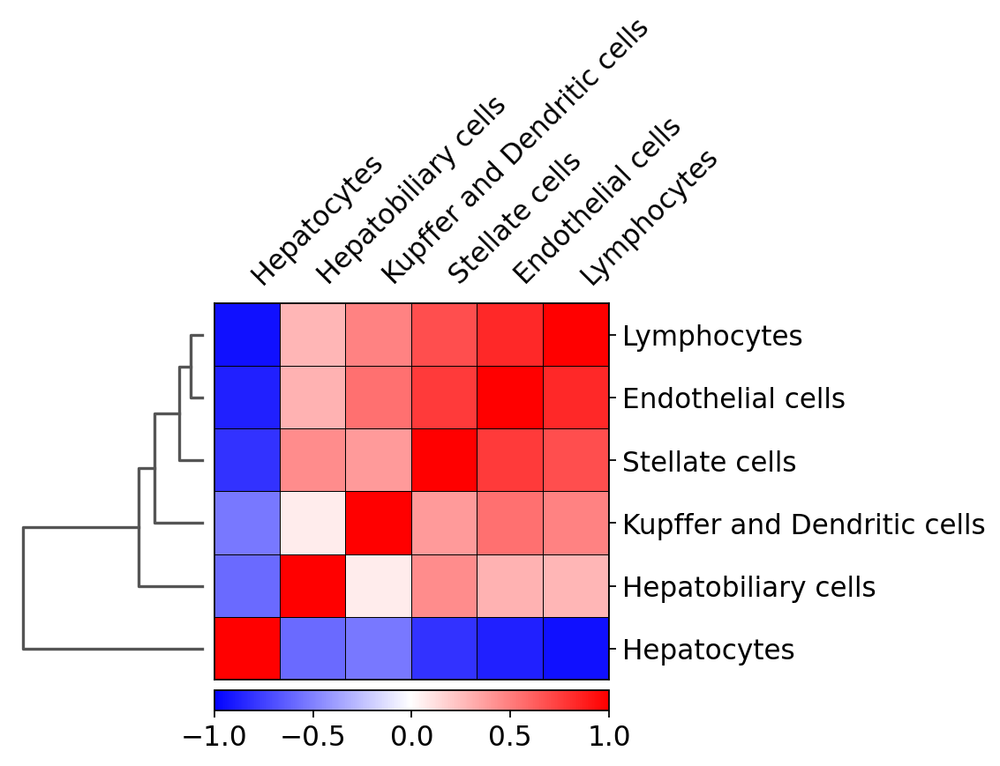

In [16]:
sc.pl.correlation_matrix(adata_young, groupby="cell_type1",save='_'+today+"_young_" + ko_prefix + "_correlation_matrix.pdf")

## Old mice only

In [54]:
adata_old = adata[adata.obs['age_grouped']=='old'].copy()

/home/icb/maren.buettner/anaconda3/envs/sc-tutorial/lib/python3.8/site-packages/anndata/_core/anndata.py:1094: FutureWarning: is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead
  if not is_categorical(df_full[k]):


### Select CEBPA knock out cells

Select wild type and CEBPA KO cells.

In [55]:
ko_prefix = 'CEBPA-KO'
strain = 'CEBPA KO'

In [56]:
adata_old = adata_old[np.in1d(adata_old.obs['strain'],['C57Bl6/J', strain])]

In [57]:
adata_old

View of AnnData object with n_obs × n_vars = 2019 × 30520
    obs: 'batch', 'exp.', 'libraryID', 'experiment', 'strain', 'age', 'sex', 'ploidy', 'ERCC.dilution', 'column', 'row', 'percentERCC', 'n_counts', 'age_grouped', 'n_counts_raw', 'n_counts_transcripts', 'n_counts_ERCC', 'n_genes', 'high_ERCC', 'low_ERCC', 'low_genes', 'high_genes', 'low_counts', 'high_counts', 'ERCC_size_factor', 'n_counts_TPM', 'RPK_factor', 'n_counts_TPM_norm', 'mean_transcript_count_TPM', 'cyclone_phases', 'score_G1', 'score_S', 'score_G2M', 'cell_type', 'cell_type1'
    var: 'length', 'gene_name', 'chromosomes', 'start', 'end', 'n_counts', 'mean_exp_TPM', 'median_exp_TPM'
    uns: 'ERCC.dilution_colors', 'age_colors', 'age_grouped_colors', 'cyclone_phases_colors', 'exp._colors', 'neighbors', 'pca', 'ploidy_colors', 'strain_colors', 'umap'
    obsm: 'X_pca', 'X_tsne', 'X_umap'
    varm: 'PCs'
    layers: 'counts', 'norm_counts', 'raw', 'raw_bin'
    obsp: 'connectivities', 'distances'

Recompute embeddings.

In [58]:
sc.pp.pca(adata_old, svd_solver='arpack')
sc.pp.neighbors(adata_old)
sc.tl.tsne(adata_old, perplexity=40, n_pcs=15)

/home/icb/maren.buettner/anaconda3/envs/sc-tutorial/lib/python3.8/site-packages/anndata/_core/anndata.py:1192: FutureWarning: is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead
  if is_string_dtype(df[key]) and not is_categorical(df[key])


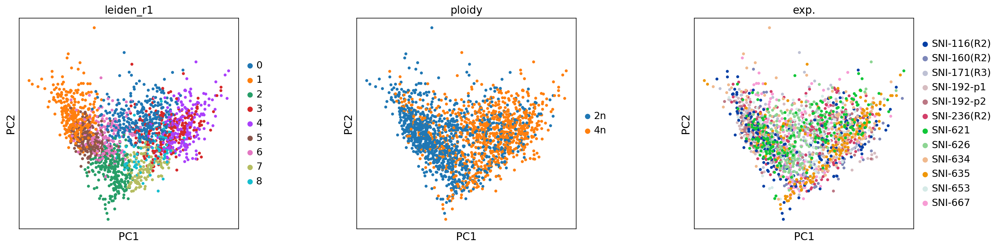

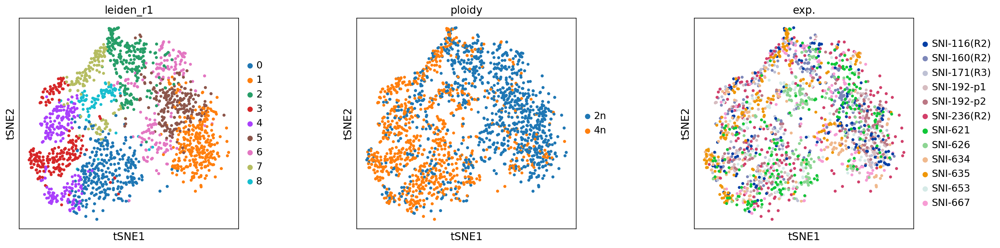

In [59]:
sc.tl.leiden(adata_old, resolution=1, key_added='leiden_r1')
rcParams['figure.figsize']=(5,5)
sc.pl.pca(adata_old, wspace=0.4, color=["leiden_r1", "ploidy","exp."])
sc.pl.tsne(adata_old, wspace=0.4, color=["leiden_r1", "ploidy","exp."])

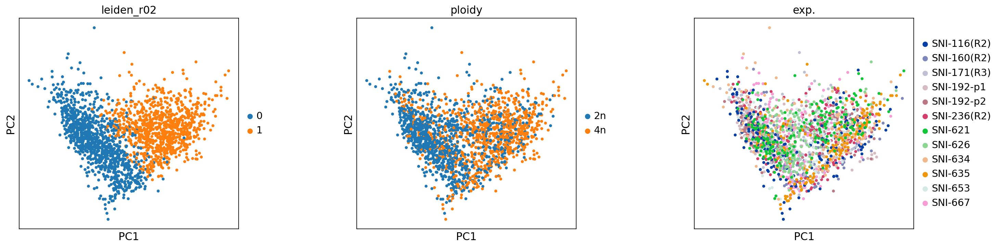

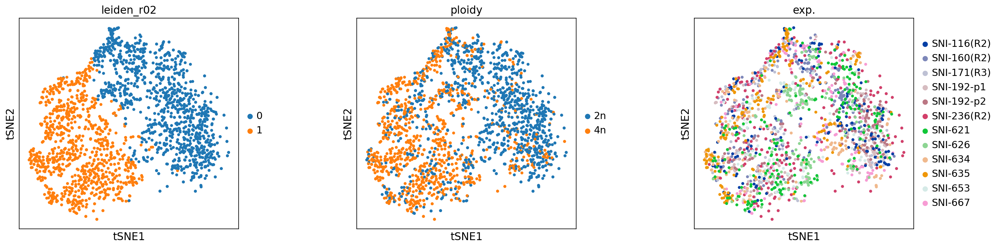

In [60]:
# low resolution louvain clustering to separate hepatocytes from non-parenchymal cells
sc.tl.leiden(adata_old, resolution=0.2, key_added='leiden_r02')
sc.pl.pca(adata_old, wspace=0.4, color=["leiden_r02", "ploidy","exp."])
sc.pl.tsne(adata_old, wspace=0.4, color=["leiden_r02", "ploidy","exp."])

In [61]:
adata_old.obs['low_res_ct'] = adata_old.obs['leiden_r02']

Label 4n cells that are in the non-parenchymal cluster.

In [62]:
adata_old.obs['clusters'] = "2-2n"
adata_old.obs['clusters'].loc[np.logical_and(adata_old.obs['low_res_ct']=='1', 
                                             adata_old.obs['ploidy']=='2n')] = "2n_hepatocytes"
adata_old.obs['clusters'].loc[np.logical_and(adata_old.obs['low_res_ct']=='1', 
                                             adata_old.obs['ploidy']=='4n')] = "4n_hepatocytes"
adata_old.obs['clusters'].loc[np.logical_and(adata_old.obs['low_res_ct']=='0', 
                                             adata_old.obs['ploidy']=='2n')] = "2n_other_cluster"
adata_old.obs['clusters'].loc[np.logical_and(adata_old.obs['low_res_ct']=='0', 
                                             adata_old.obs['ploidy']=='4n')] = "4n_other_cluster"
adata_old.obs['clusters'] = adata_old.obs['clusters'].astype('category')

/home/icb/maren.buettner/anaconda3/envs/sc-tutorial/lib/python3.8/site-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)


In [63]:
adata_old.obs['clusters'].value_counts()

2n_other_cluster    841
4n_hepatocytes      694
2n_hepatocytes      251
4n_other_cluster    233
Name: clusters, dtype: int64

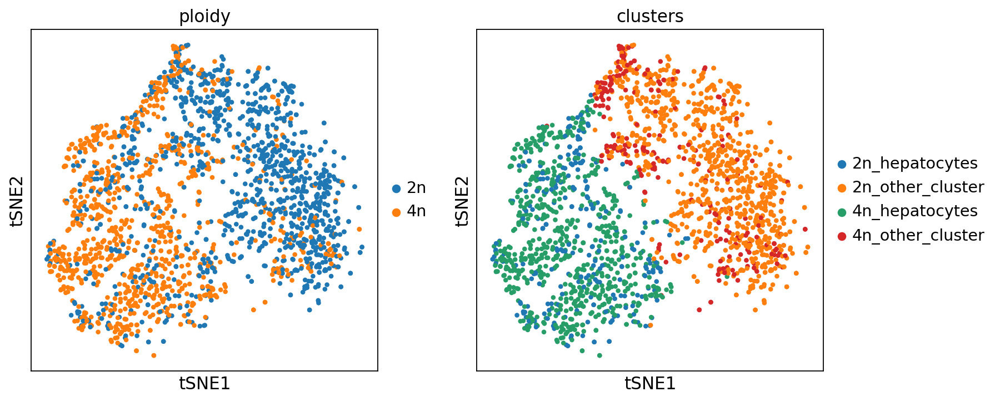

In [64]:
rcParams['figure.figsize']=(5,5)
sc.pl.tsne(adata_old, color=['ploidy', 'clusters'])

Compute a gene set score for every gene set.

In [65]:
for key in cell_type_id_dict.keys():
    sc.tl.score_genes(adata_old, cell_type_id_dict[key], score_name='score_' + key, use_raw=True)

/home/icb/maren.buettner/anaconda3/envs/sc-tutorial/lib/python3.8/site-packages/anndata/_core/anndata.py:1192: FutureWarning: is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead
  if is_string_dtype(df[key]) and not is_categorical(df[key])


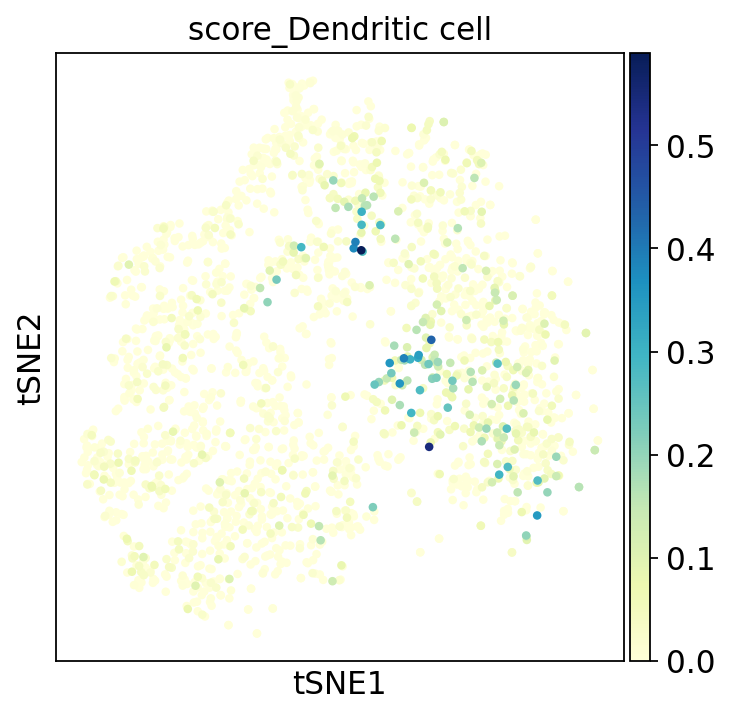

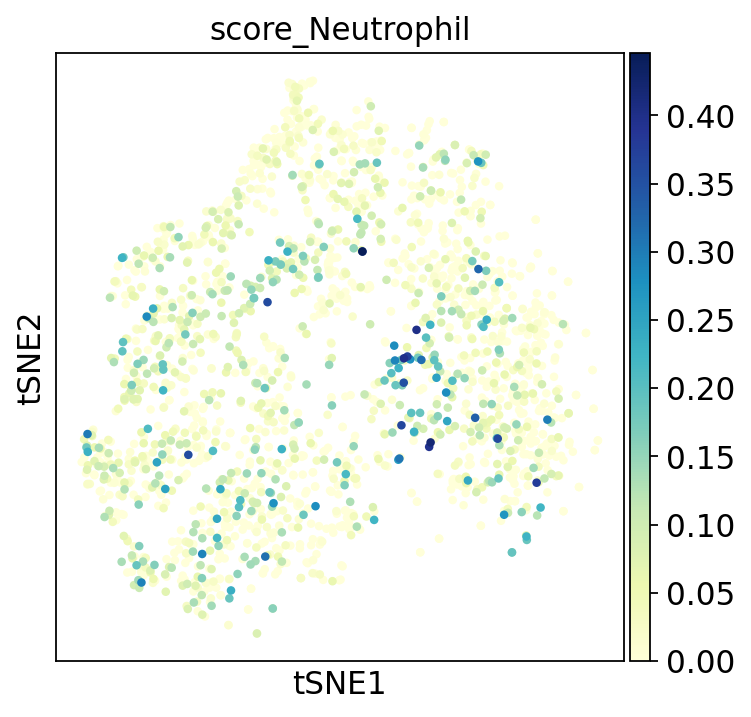

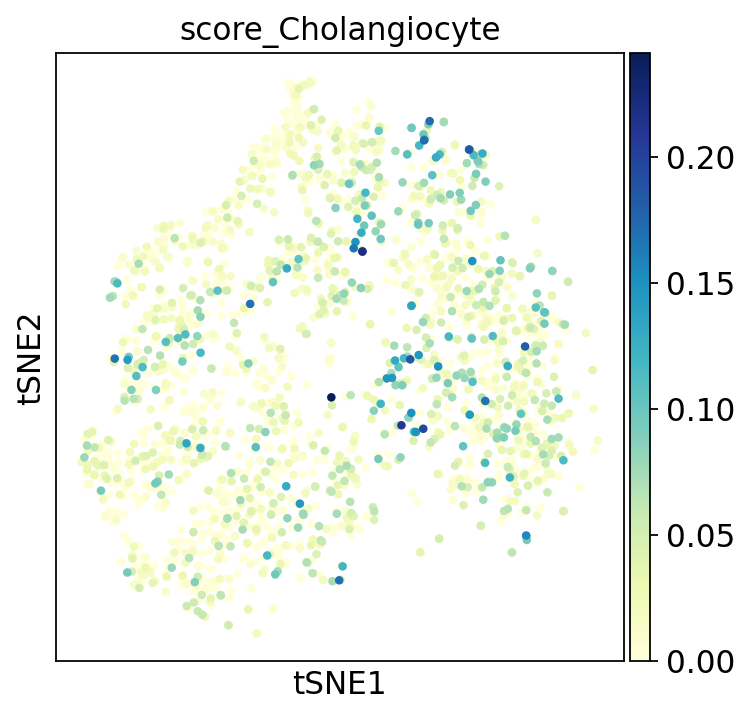

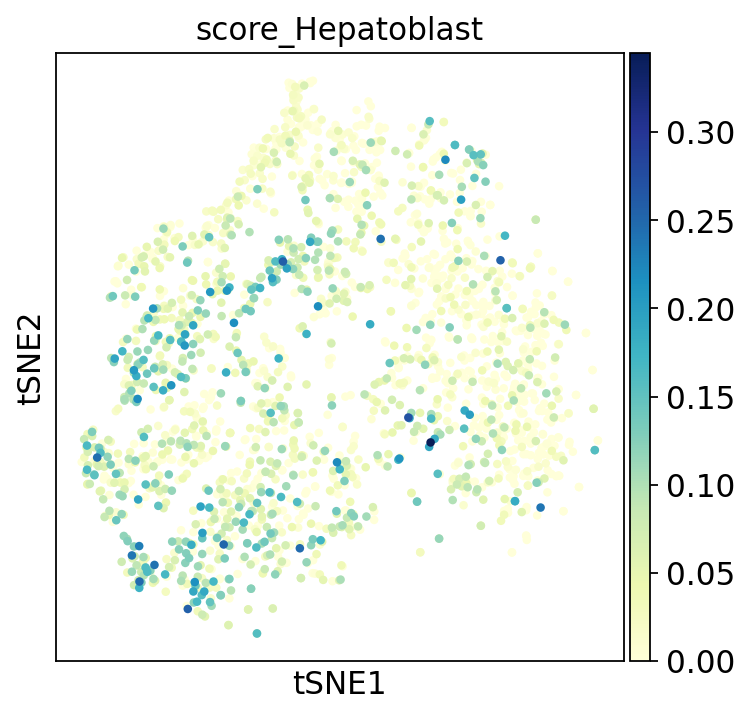

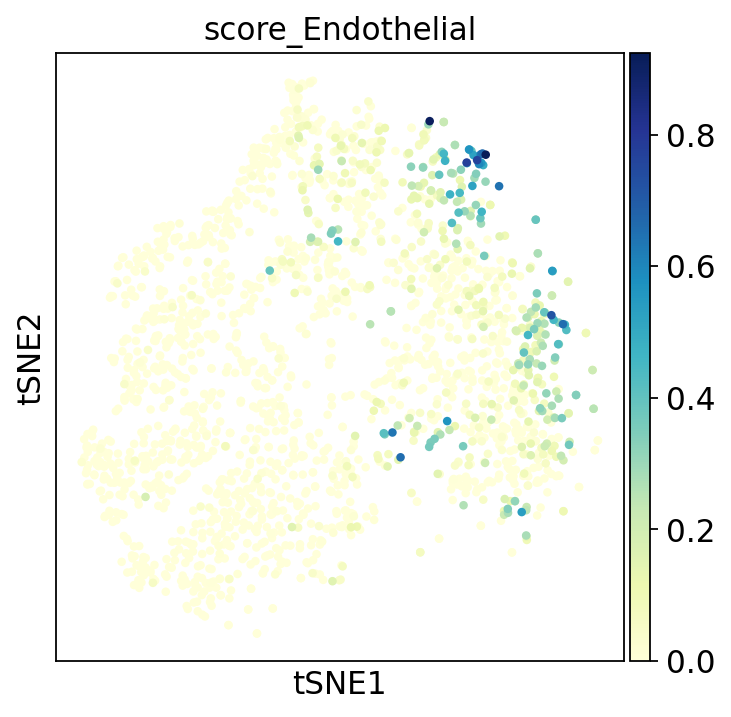

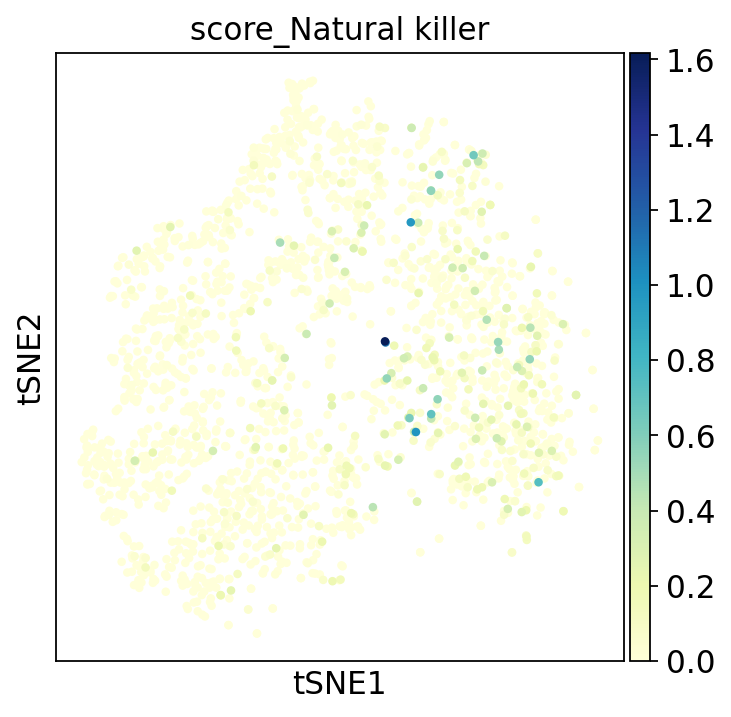

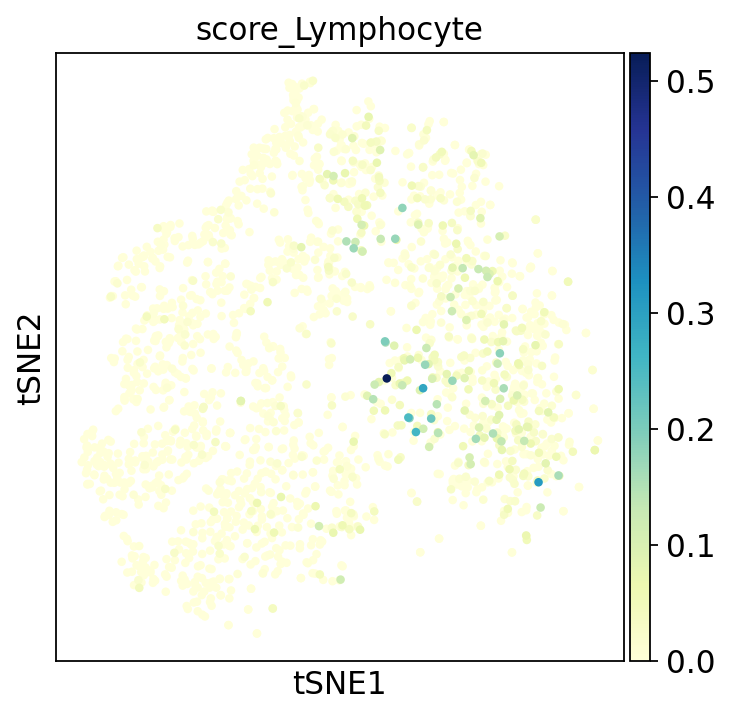

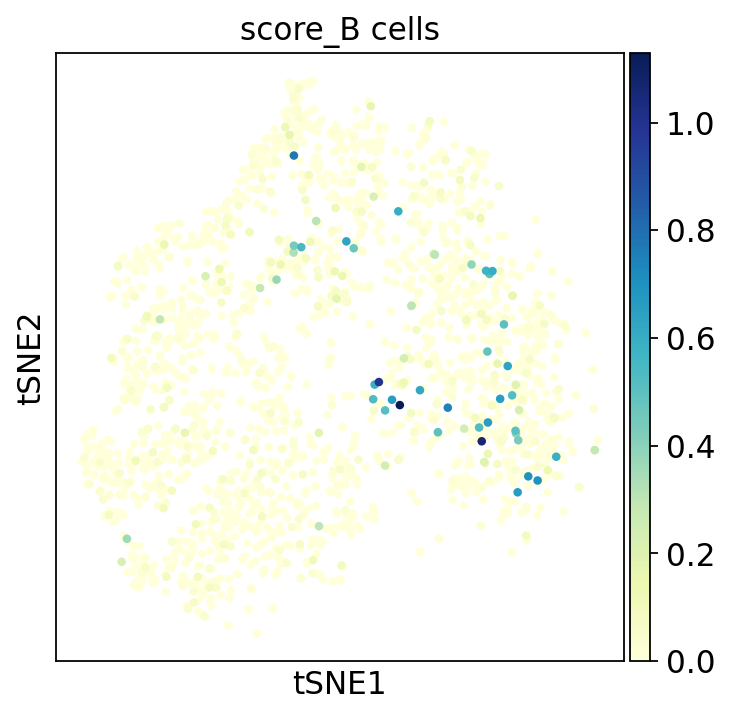

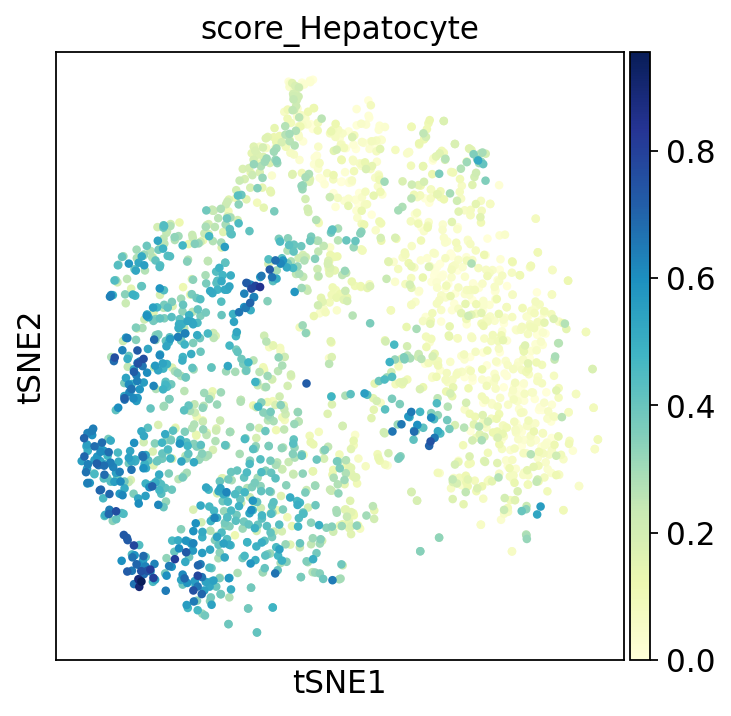

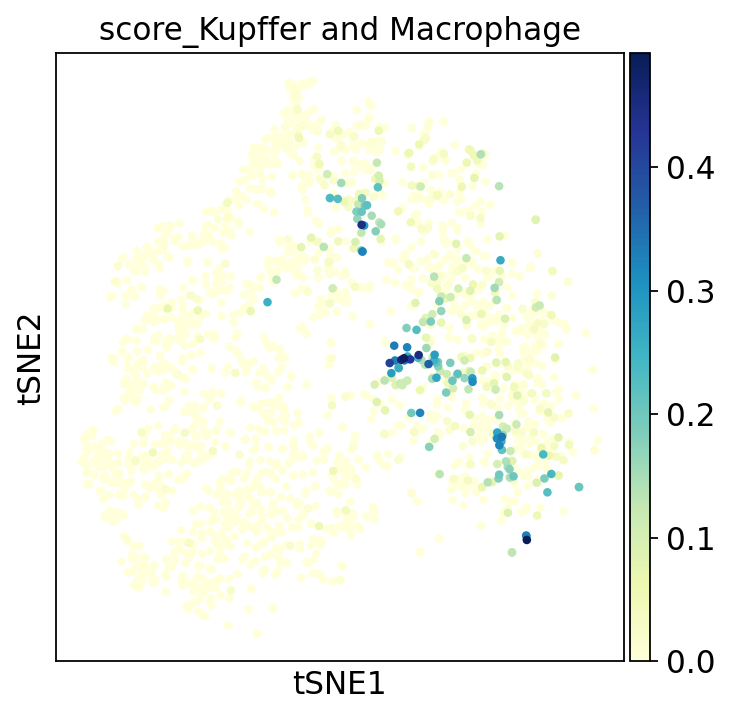

In [66]:
rcParams['figure.figsize']=(5,5)
for key in cell_type_id_dict.keys():
    sc.pl.tsne(adata_old, color='score_' + key, cmap='YlGnBu', vmin=0)

/home/icb/maren.buettner/anaconda3/envs/sc-tutorial/lib/python3.8/site-packages/anndata/_core/anndata.py:1192: FutureWarning: is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead
  if is_string_dtype(df[key]) and not is_categorical(df[key])


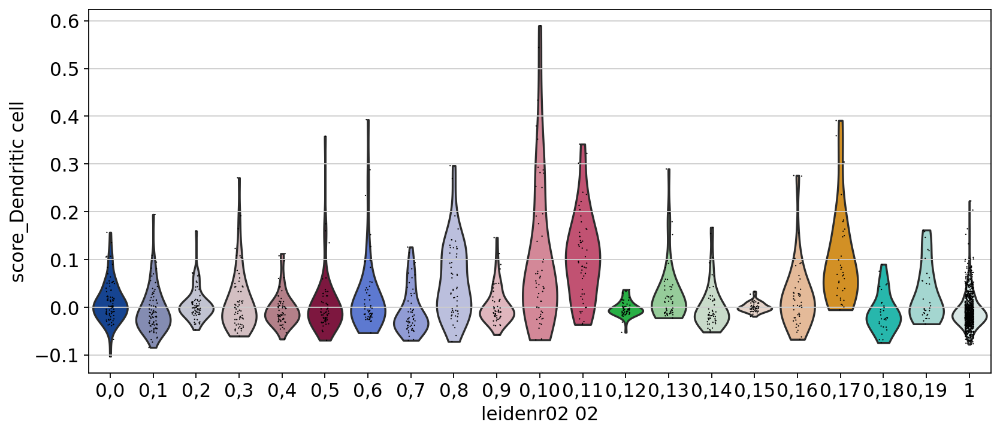

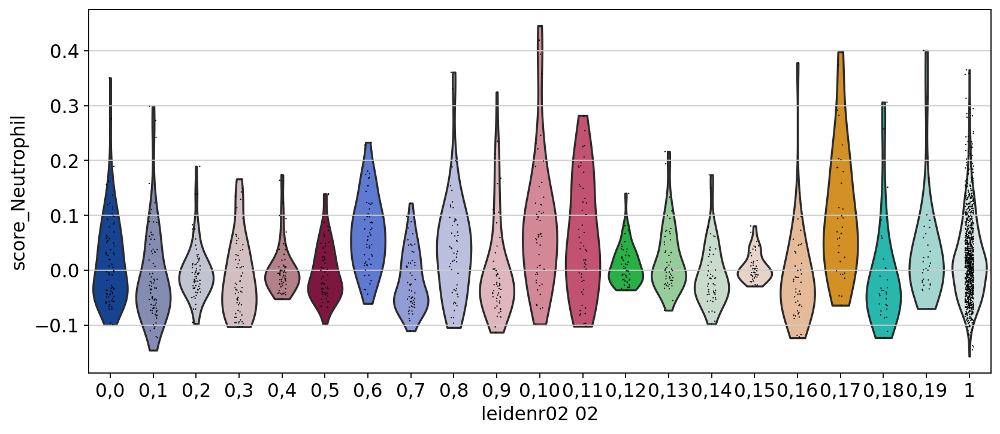

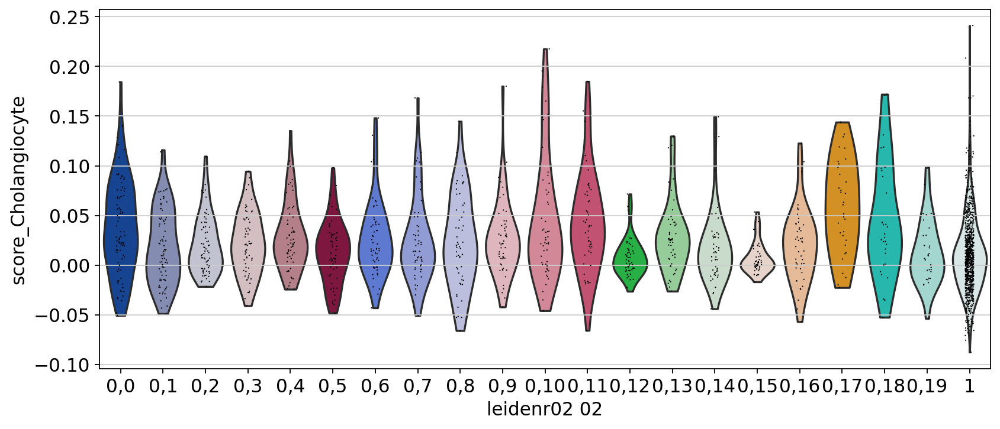

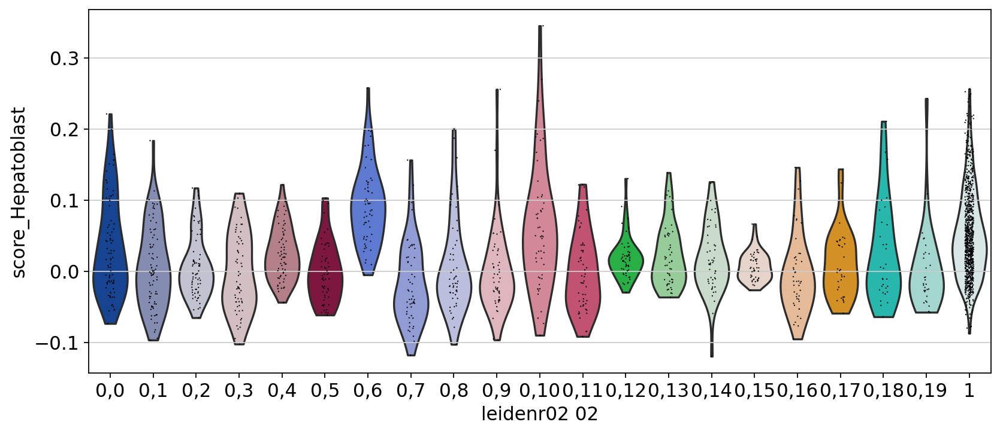

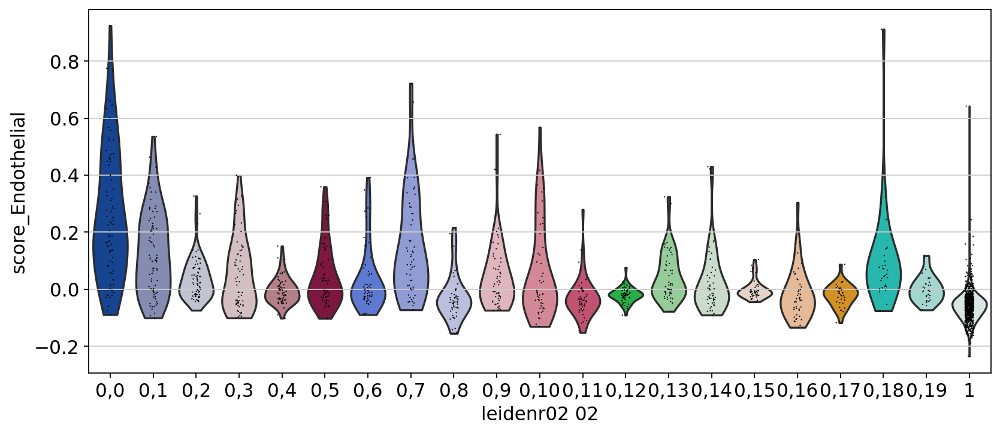

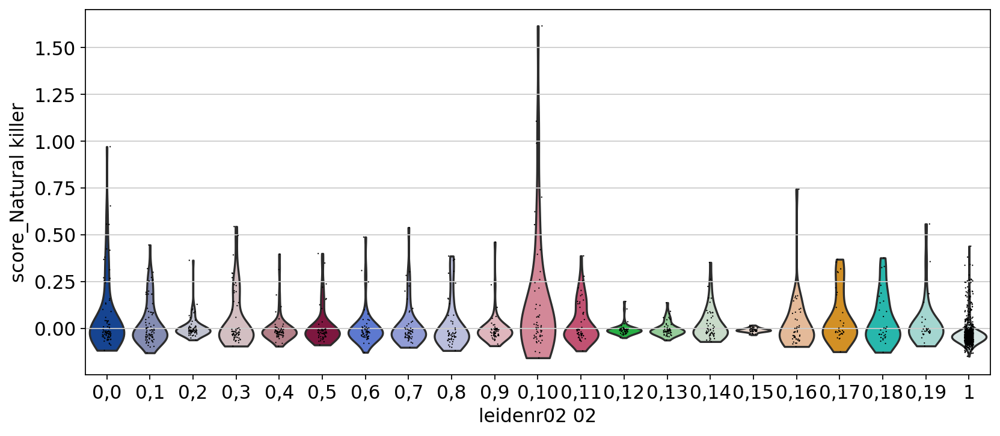

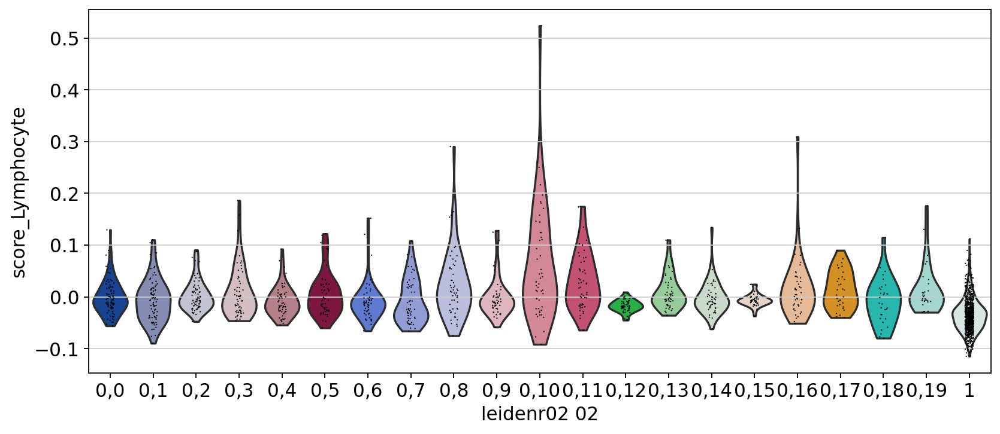

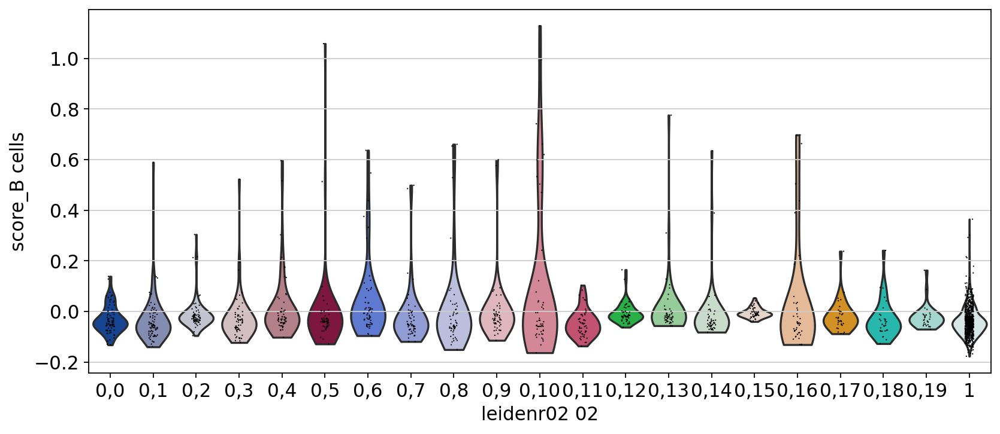

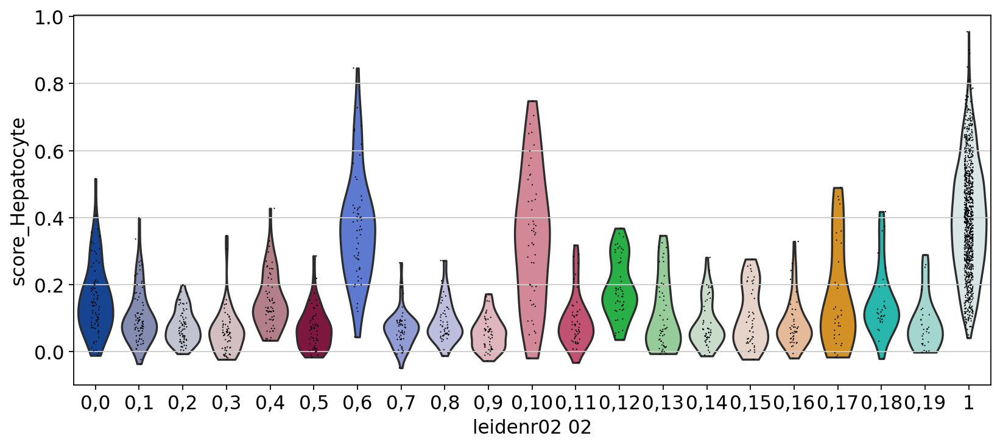

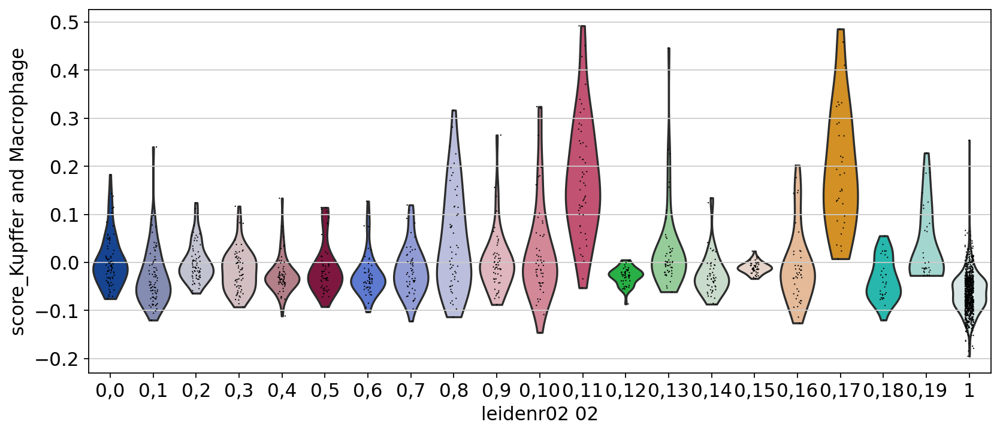

In [70]:
rcParams['figure.figsize']=(10,5)
for key in cell_type_id_dict.keys():
    sc.pl.violin(adata_old, keys='score_' + key, groupby='leidenr02_02')

Subcluster non-hepatocytes.

In [67]:
rcParams['figure.figsize']=(5,5)
# high resolution clustering for the non-parenchymal cells
sc.tl.leiden(adata_old, resolution=2.5, key_added='leidenr02_02', restrict_to=['leiden_r02', ['0']])
#sc.tl.louvain(adata, resolution=0.75, key_added='louvainr02_02', restrict_to=['louvainr02_02', ['1,0']])
#sc.tl.louvain(adata, resolution=0.5, key_added='louvainr02_02', restrict_to=['louvainr02_02', ['0']])
#sc.tl.louvain(adata, resolution=0.75, key_added='louvainr02_02', restrict_to=['louvainr02_02', ['0,2']])

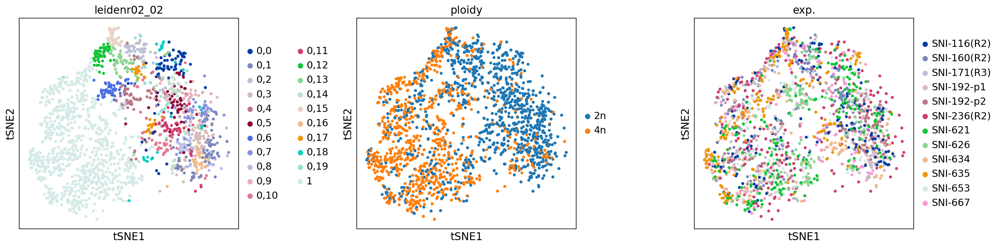

In [68]:
sc.pl.tsne(adata_old, wspace=0.4, color=["leidenr02_02", "ploidy","exp."])

In [69]:
pd.crosstab(adata_old.obs['leidenr02_02'],adata_old.obs['cell_type'])

cell_type,2n Hepatocytes,4n Hepatocytes,Hepatobiliary cells,Endothelial cells,Kupffer and Dendritic cells,Lymphocytes,Stellate cells,not annotated
leidenr02_02,,,,,,,,
"0,0",2,0,0,17,3,15,0,44
"0,1",1,3,1,29,0,14,0,32
"0,2",9,5,0,0,2,3,13,38
"0,3",0,0,0,7,0,35,0,21
"0,4",16,21,0,0,0,1,2,21
"0,5",1,0,0,3,1,21,1,29
"0,6",13,15,4,5,0,0,0,18
"0,7",0,0,0,15,0,19,1,20
"0,8",0,0,0,6,1,30,0,17


Annotate based on majority vote.

In [71]:

adata_old.obs["cell_type"].loc[np.logical_and(adata_old.obs["cell_type"]=='not annotated',
                                              np.in1d(adata_old.obs["leidenr02_02"], 
                                         ['0,10']))] = 'Hepatobiliary cells'
adata_old.obs["cell_type"].loc[np.logical_and(adata_old.obs["cell_type"]=='not annotated',
                                              np.in1d(adata_old.obs["leidenr02_02"], 
                                         ['0,11', '0,13','0,17']))] = 'Kupffer and Dendritic cells'
adata_old.obs["cell_type"].loc[np.logical_and(adata_old.obs["cell_type"]=='not annotated',
                                              np.in1d(adata_old.obs["leidenr02_02"], 
                                         ['0,2', '0,18']))] = 'Stellate cells' 
adata_old.obs["cell_type"].loc[np.logical_and(adata_old.obs["cell_type"]=='not annotated',
                                              np.in1d(adata_old.obs["leidenr02_02"], 
                                         ['0,0', '0,1','0,7']))] = 'Endothelial cells'
adata_old.obs["cell_type"].loc[np.logical_and(adata_old.obs["cell_type"]=='not annotated',
                                              np.in1d(adata_old.obs["leidenr02_02"], 
                                         ['0,3','0,5', '0,8','0,9','0,14', '0,16', '0,19']))] = 'Lymphocytes'



adata_old.obs["cell_type"][np.logical_and(adata_old.obs["cell_type"]=='not annotated',
                                          np.logical_and(adata_old.obs["clusters"]=='2n_other_cluster',
                                          np.in1d(adata_old.obs['leidenr02_02'],['0,4','0,6', '0,12', '0,15'])
                                         ))] = '2n Hepatocytes'
adata_old.obs["cell_type"][np.logical_and(adata_old.obs["cell_type"]=='not annotated',
                                          np.logical_and(adata_old.obs["clusters"]=='4n_other_cluster',
                                          np.in1d(adata_old.obs['leidenr02_02'],['0,4','0,6', '0,12', '0,15'])
                                         ))] = '4n Hepatocytes'

adata_old.obs["cell_type"][adata_old.obs["clusters"]=='2n_hepatocytes'] = '2n Hepatocytes'
adata_old.obs["cell_type"][adata_old.obs["clusters"]=='4n_hepatocytes'] = '4n Hepatocytes'
adata_old.obs['cell_type'] = adata_old.obs['cell_type'].cat.remove_unused_categories() 


In [72]:
proportions_old = pd.crosstab(adata_old.obs['cell_type'], adata_old.obs['strain'], normalize=1, margins=True)*100

In [73]:
proportions_old

strain,C57Bl6/J,CEBPA KO,All
cell_type,,,
2n Hepatocytes,14.723404,22.511848,17.979198
4n Hepatocytes,43.489362,36.018957,40.366518
Hepatobiliary cells,2.893617,1.421801,2.278356
Endothelial cells,8.000000,11.374408,9.410599
Kupffer and Dendritic cells,6.893617,5.331754,6.240713
Lymphocytes,20.680851,16.824645,19.068846
Stellate cells,3.319149,6.516588,4.655770


In [74]:
proportions_old.to_csv(data_dir + 'cell_counts_old_' + ko_prefix +'_'+ today + '.csv')

Set cell type colors.

In [78]:
adata_old.uns["cell_type_colors"] = ["#1f77b4", "#ff7f0e",
                                       #"#332288", "#332288", #Hepatocyte color
                                       "#8c564b",
                                       "#DC050C","#FFAABB","#ade8e3","#17becf"]

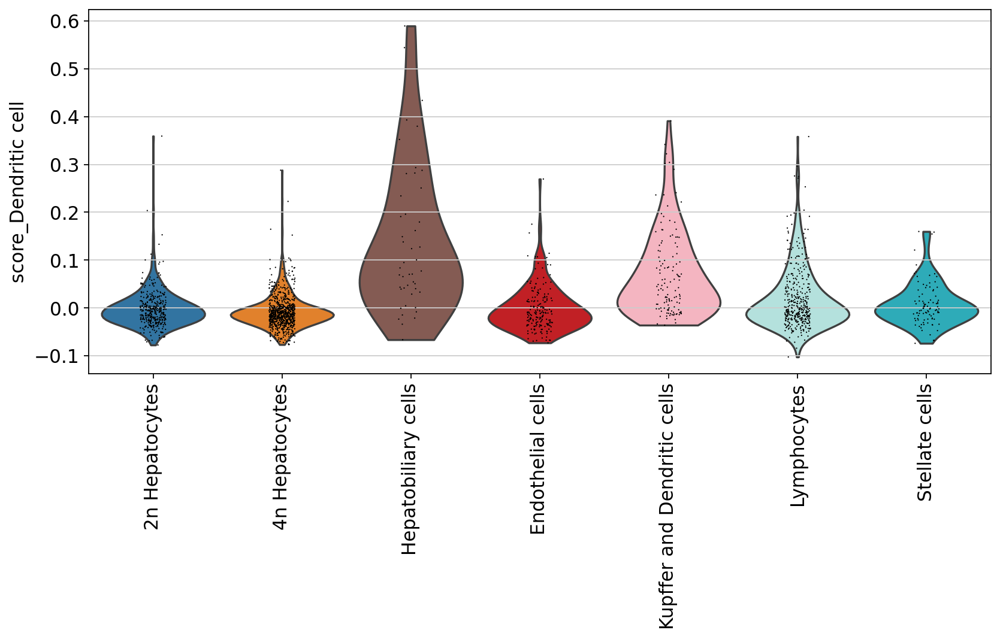

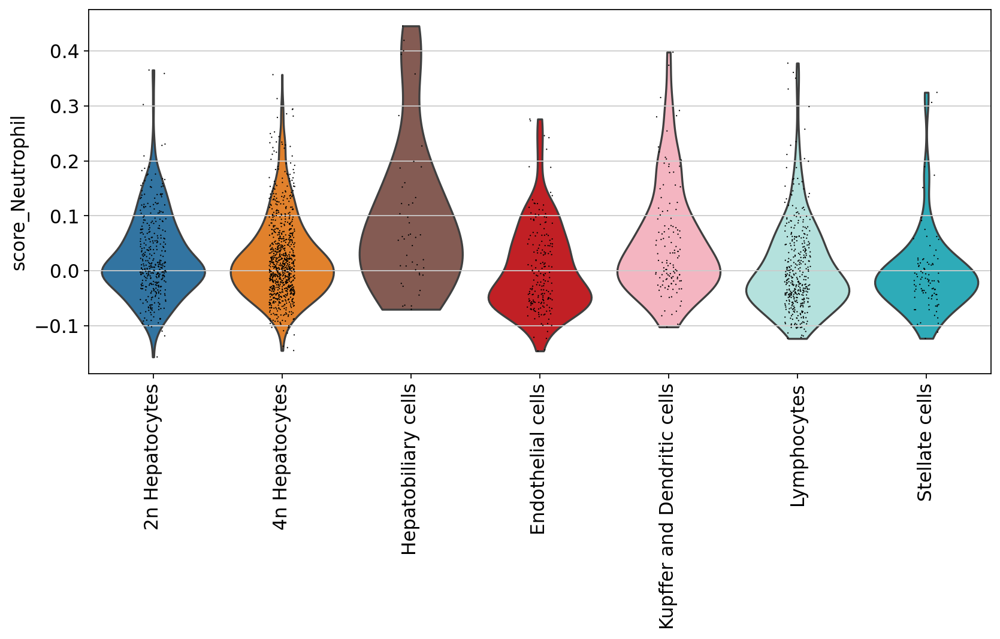

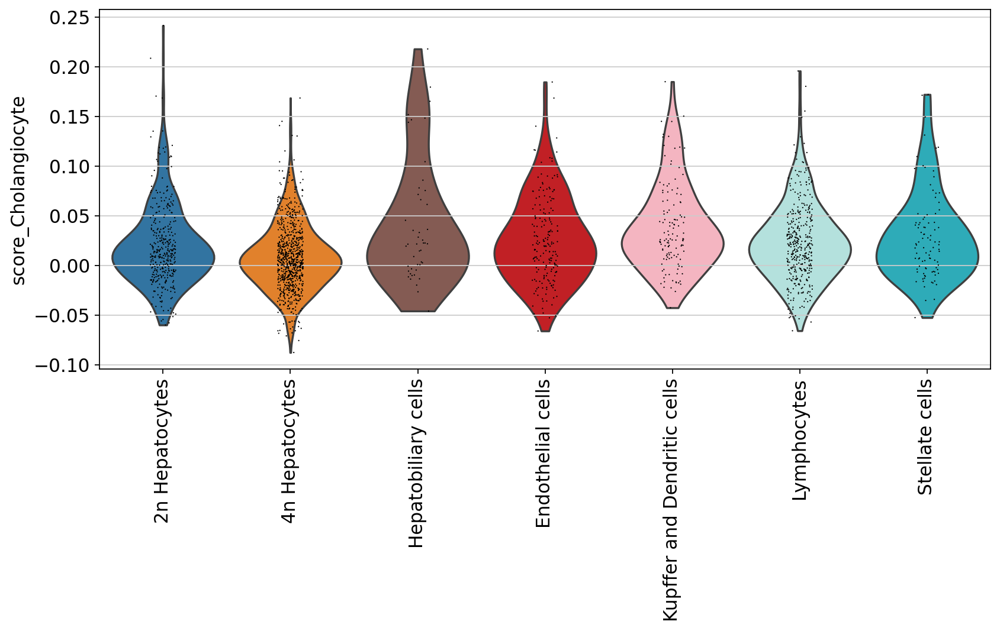

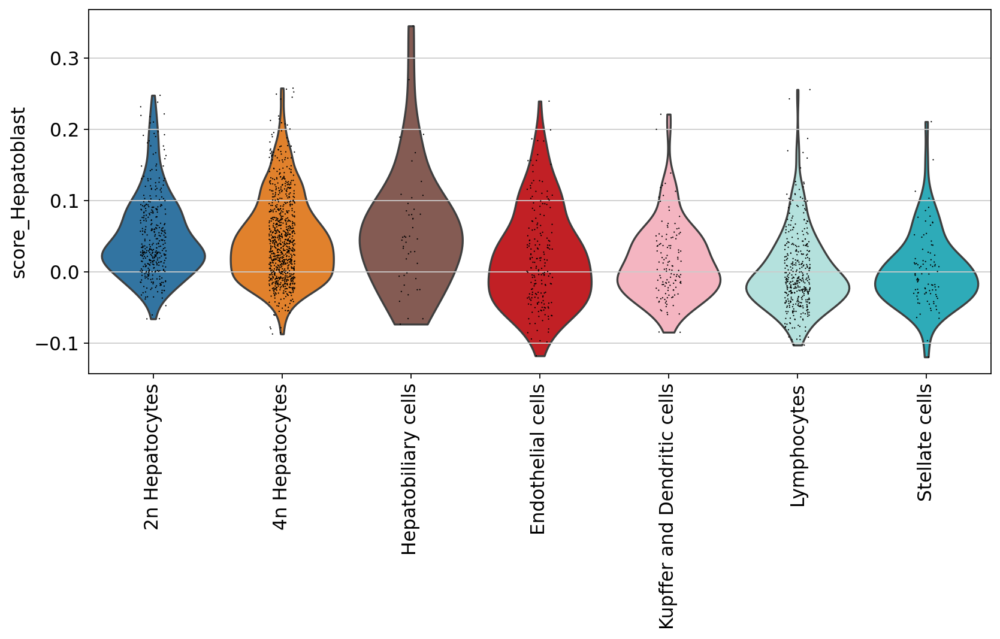

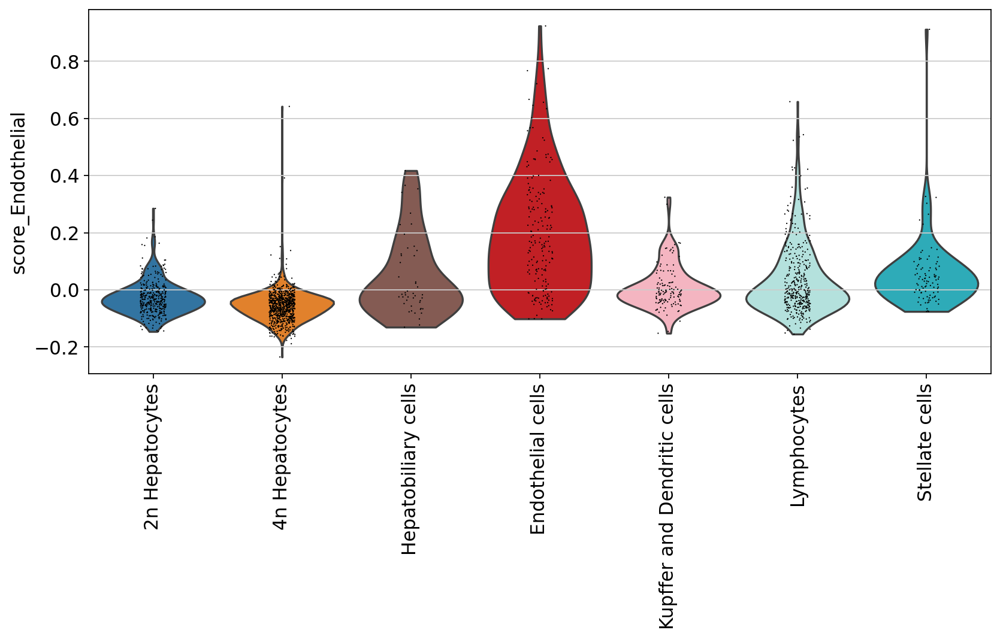

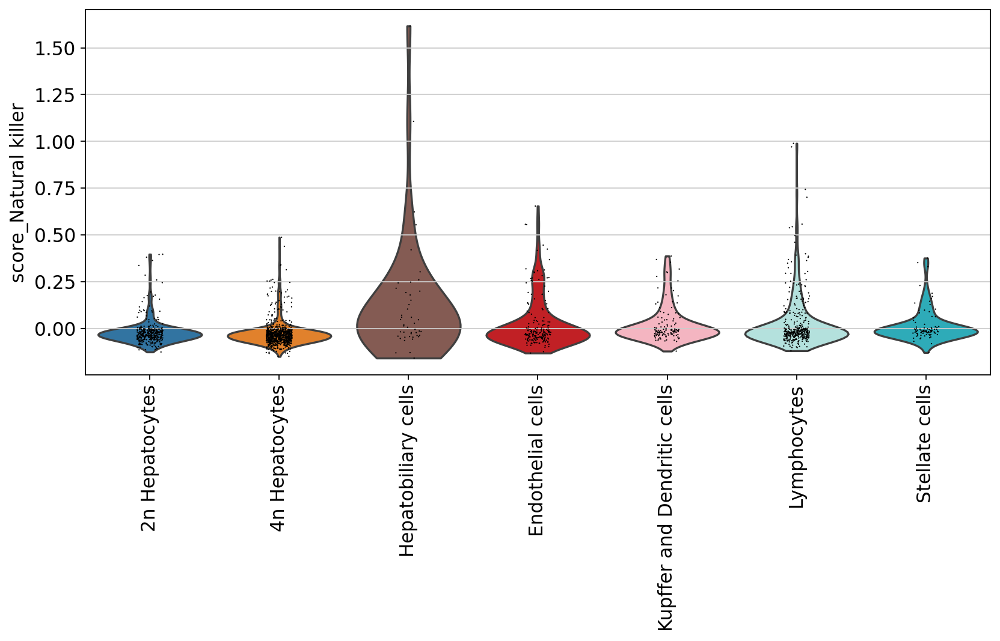

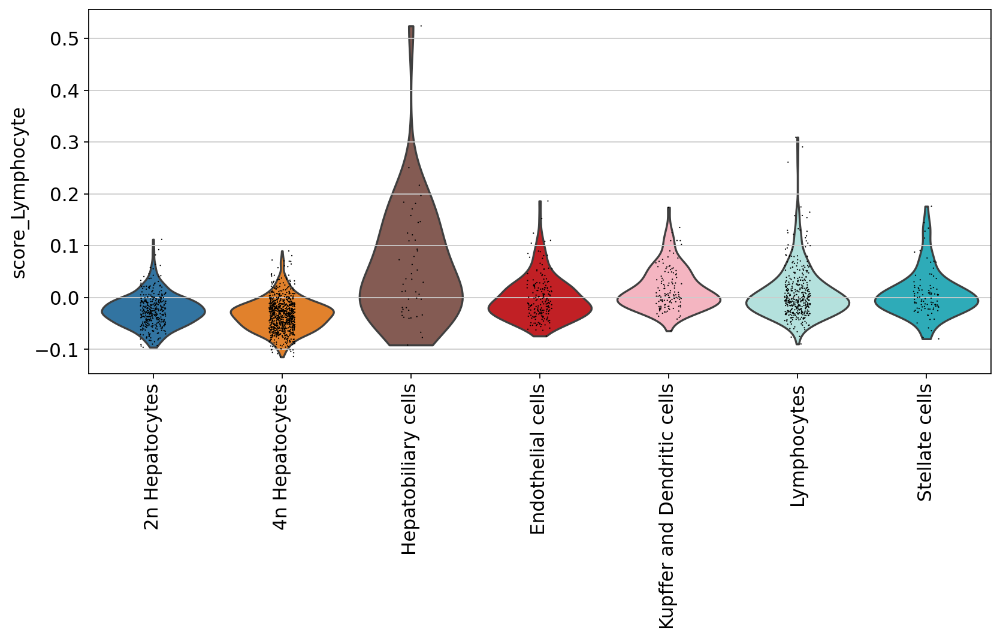

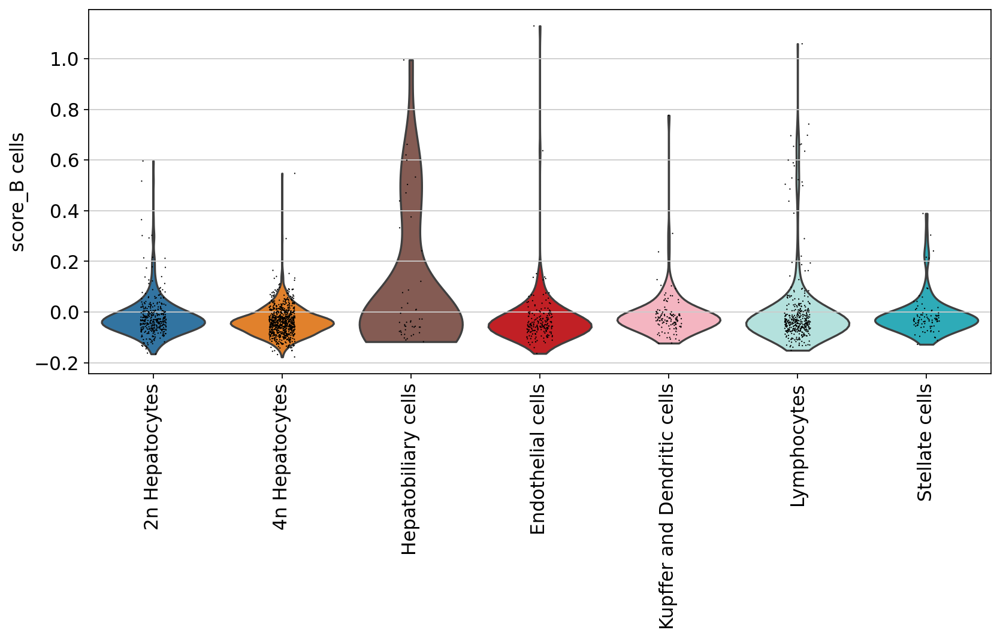

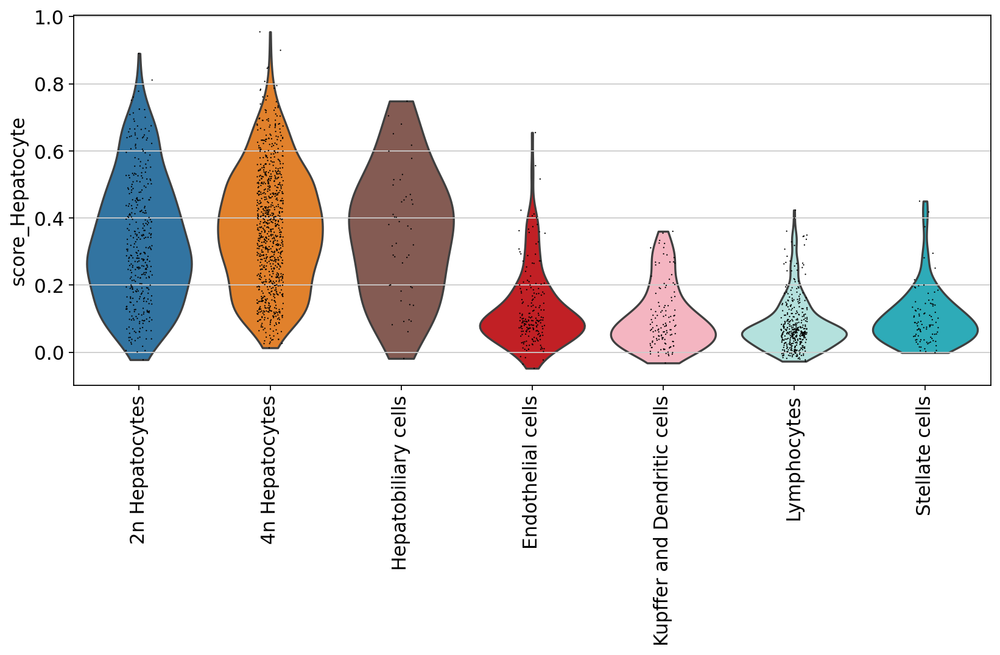

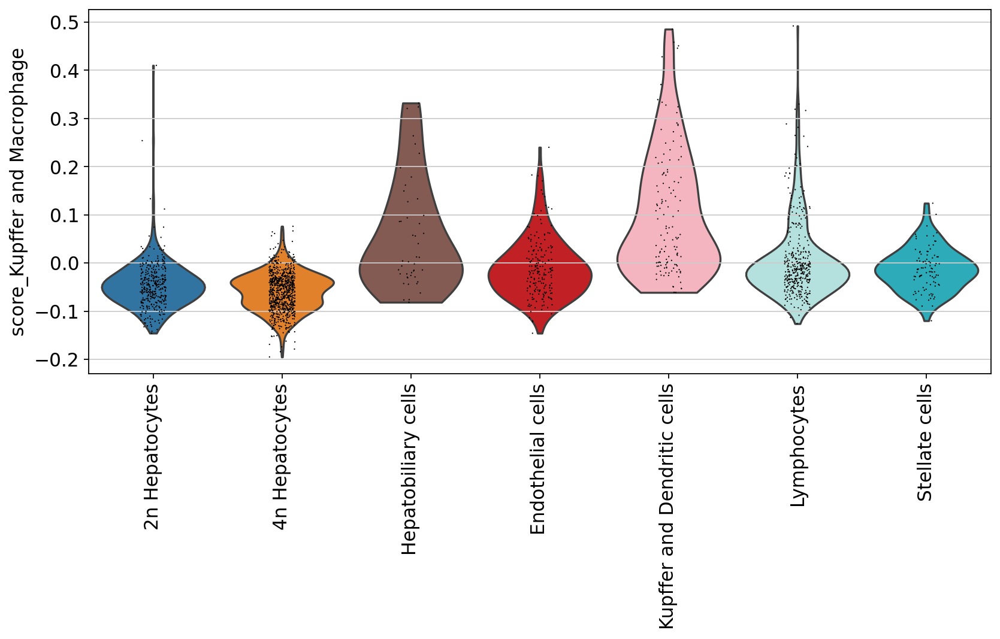

In [82]:
rcParams['figure.figsize']=(10,5)
for key in adata_old.obs.keys():
    if key.startswith('score_'):
        phase_key = key.split('_')[1] #do not show cell cycle scores
        if phase_key.startswith('G') or phase_key.startswith('S'):
            continue
        sc.pl.violin(adata_old, keys=key, groupby='cell_type', rotation=90)

Select knock out cells only and recompute embedding.

In [83]:
adata_old = adata_old[adata_old.obs['strain']==strain]

/home/icb/maren.buettner/anaconda3/envs/sc-tutorial/lib/python3.8/site-packages/anndata/_core/anndata.py:1094: FutureWarning: is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead
  if not is_categorical(df_full[k]):


In [84]:
sc.pp.pca(adata_old, svd_solver='arpack')
sc.pp.neighbors(adata_old)
sc.tl.tsne(adata_old, perplexity=30, n_pcs=10)

In [85]:
chol_markers = ['Sptbn1','Sox9','Sox4','Kit','Slc22a3',
                'Hnf1b','Erbb3','Fgfr2','Fgfr3','Sorl1','Wwc1',
                'Cftr','Pkd2','Pkhd1l1','Lrp2','Cdh11','Igfbp5','Wt1','Igfbp6',
                'Wnt2b','Bmp4','Sulf2','Gas1','Gpc3','Vim','Fgf1','Onecut1',
                'Klra2','Ccl5','Pla2g7','Clec12a','Itgal','Folr2','Cybb','Cd38',
                'Epcam','Cdh1']

hepatoblast_markers = ["Ncam1","Cd44","Dlk1","Icam1","Epcam","Cdh1","Onecut3","Afp","Agt","Fgg",
                       "Gsta1","Id3","Lin28b","Etv5","Lgr5","Tbx3","Foxm1","Kit",
                      "Onecut1","Onecut2","Notch2","Tbx3","Hnf1b","Hes1","Foxa2","Foxa3","Hhex",
                       "Sall4","Hnf4a","Alb","Krt19","Epcam","Tacstd2","Anpep","Itga6","Cd133",
                       "Thy1","Fgf7","Sox9","Krt18","Krt19","Cebpa","Serpina16","Mki67","Krt7",
                       "Tmem45b","Tacstd2","Igdcc4","Itga6","Ptprcap","Atxn1"]

nmarker_name = {}
nmarker_id = []
index = 0
for n in adata_old.var["gene_name"].tolist():
    if n in hepatoblast_markers:
        nmarker_name[n] = adata_old.var_names[index]
        nmarker_id.append(adata_old.var_names[index])
    index += 1

adatah = adata_old[:,nmarker_id].copy()

/home/icb/maren.buettner/anaconda3/envs/sc-tutorial/lib/python3.8/site-packages/anndata/_core/anndata.py:1094: FutureWarning: is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead
  if not is_categorical(df_full[k]):


In [86]:
adata_old.obs["hblast_marker_sum"] = np.sum(adatah.layers["raw"], axis=1)

Color the clusters nicely

In [87]:
adata_old.uns["low_res_ct_colors"] = ["#686868", "#a9a9a9"]

Combine the hepatocytes and re-arrange the levels.

In [88]:
adata_old.obs['cell_type1'] = adata_old.obs['cell_type'].cat.add_categories(['Hepatocytes'])
adata_old.obs['cell_type1'][np.in1d(adata_old.obs['cell_type'], ["2n Hepatocytes", "4n Hepatocytes"])] = 'Hepatocytes'
adata_old.obs['cell_type1'] = adata_old.obs['cell_type1'].cat.remove_unused_categories()
adata_old.obs['cell_type1'] = adata_old.obs['cell_type1'].cat.reorder_categories(['Hepatocytes', 
                                              'Hepatobiliary cells', 'Endothelial cells', 
                                     "Kupffer and Dendritic cells", 'Lymphocytes','Stellate cells',
                                   
                                                                         ])

In [89]:
adata_old.uns["cell_type1_colors"] = ["#332288", #Hepatocyte color
                                       "#8c564b",
                                       "#DC050C","#FFAABB","#ade8e3","#17becf"]

/home/icb/maren.buettner/anaconda3/envs/sc-tutorial/lib/python3.8/site-packages/anndata/_core/anndata.py:1192: FutureWarning: is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead
  if is_string_dtype(df[key]) and not is_categorical(df[key])


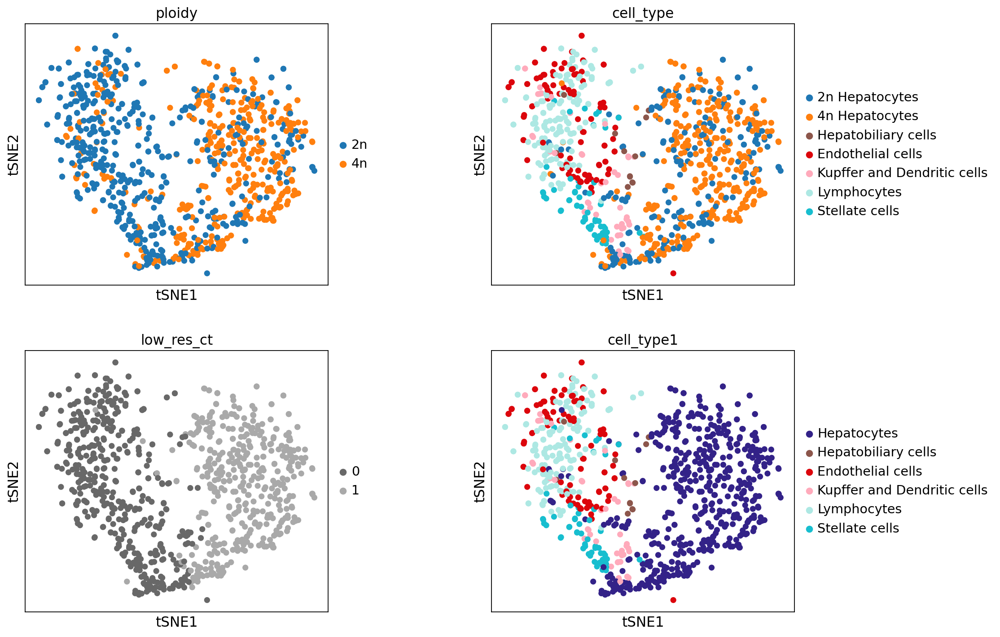

In [91]:
rcParams['figure.figsize']=(5,5)
sc.pl.tsne(adata_old, color=["ploidy", "cell_type","low_res_ct", "cell_type1"],
           ncols=2, wspace=0.4, save='_'+today +"_old_"+ko_prefix+"_prelim_annotation.pdf")

Save the annotated adata

In [92]:
adata_old.write(data_dir + 'snRNAseq_mouse_hepatocytes_old_' +ko_prefix+ '_filtered_TPM_jul21_annotated.h5ad')

/home/icb/maren.buettner/anaconda3/envs/sc-tutorial/lib/python3.8/site-packages/anndata/_core/anndata.py:1192: FutureWarning: is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead
  if is_string_dtype(df[key]) and not is_categorical(df[key])


In [17]:
adata_old = sc.read(data_dir + 'snRNAseq_mouse_hepatocytes_old_' +ko_prefix+ '_filtered_TPM_jul21_annotated.h5ad')

In [18]:
# plotting the markers nicely (using scanpy 1.6)
small_marker_dict = {"Hepatocytes":["Cyp27a1","Ppara","Pck1"],
                    "Hepatobiliary cells":["Lgr5","Id3","Fgg"],
                    "Endothelial cells":["Dnase1l3","Ptprb","Stab2", "Clec4g", "Flt1","Gpihbp1"],
                    "Kupffer and Dendritic cells":["Clec4f","Slc40a1","Cd5l", "Adgre1",  
                                                   "Cd68", "Cd163", "Vsig4", "H2-Aa"],
                    "Lymphocytes":["Bcl2","Syk","Lck", 'Lsp1'],
                     "Neutrophils":["Csf3r", "Retnlg"],
                     'Stellate cells': ['Reln'],
                    "B cells": ["Cd79a", "Bank1", "Igkc", 'Eaf2'],
                     "T cells": ["Bach2"],
                    "NK cells": ["Clec1b", "Klrb1c", "Nkg7"]}

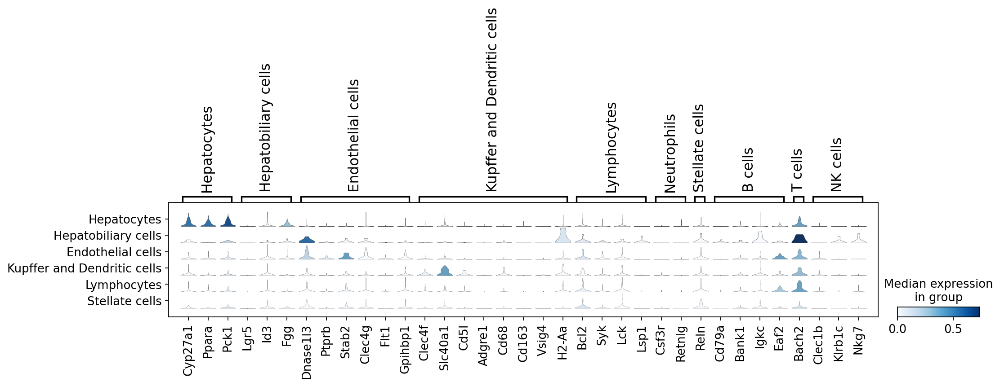

In [19]:
ax = sc.pl.stacked_violin(adata_old, gene_symbols="gene_name", groupby="cell_type1", 
                     var_names=small_marker_dict, 
                          save='_' + today + "_old_"+ko_prefix+"_prelim_annotation_markers.pdf")

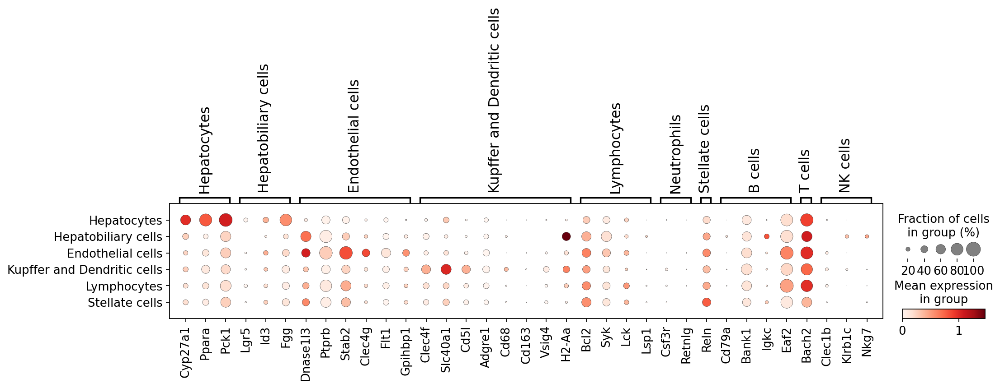

In [20]:
sc.pl.dotplot(adata_old, gene_symbols="gene_name", groupby="cell_type1", 
                     var_names=small_marker_dict, 
                          save='_' + today + "_old_"+ko_prefix+"_prelim_annotation_markers.pdf")

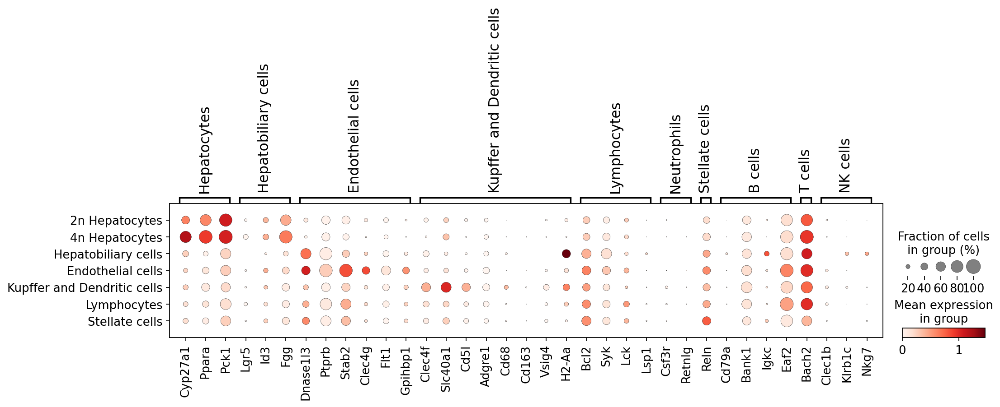

In [21]:
sc.pl.dotplot(adata_old, gene_symbols="gene_name", groupby="cell_type", 
                     var_names=small_marker_dict, 
                          save='_' + today + "_old_"+ko_prefix+"_prelim_annotation_markers2.pdf")

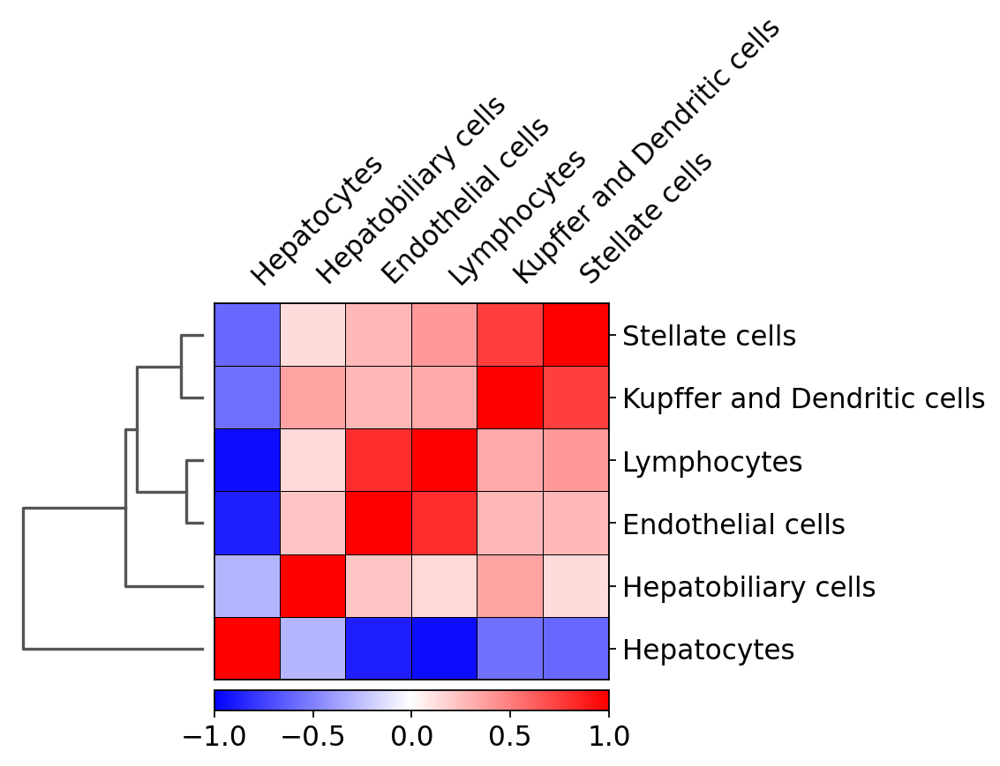

In [22]:
sc.pl.correlation_matrix(adata_old, groupby="cell_type1",
                        save='_' + today + "_old_"+ko_prefix+"_correlation_matrix.pdf")

# Cell type proportions

In [9]:
adata_all = sc.read(data_dir + 'cellxgene_all_mar21.h5ad')

Here, we combine the annotation results of old and young mice and compute the relative proportions per cell type.

In [10]:
meta_all = adata_all.obs

In [11]:
meta_all.shape

(6605, 53)

In [22]:
meta_info = meta_all[['age_grouped','ploidy', 'strain', 'cell_type1']]
meta_info['cell_count'] = 'cell_count'

<ipython-input-22-8088b3e6b003>:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  meta_info['cell_count'] = 'cell_count'


In [23]:
tmp = meta_info.groupby(['ploidy','age_grouped', 'strain', 'cell_type1', 'cell_count'])['ploidy'].count().unstack()

In [24]:

tmp = tmp.rename(columns=str).reset_index()

Please note that plate SNI-667 contains only 2n cells, all other plates are sorted 2n:4n in equal amounts. Therefore, we have to adapt the normalisation scheme to account for the increased number of 2n cells in SNI-667. Specifically, we normalise per `age group` (*i.e.* separately for young and old). The 2n cells in SNI-667 lead to an overpresentation of 2n cells each group. The plate SNI-667 contains only cells from the CEBPA KO, so the remaining strains will be normalised as usual. 

For the CEBPA KO, we have more 2n cells from SNI-667, therefore, we have to adapt the normalisation for 2n cells in the strain. 

In [26]:
adata_tmp = adata_all[adata_all.obs['strain']=='CEBPA KO'].copy()

In [32]:
pd.crosstab(adata_tmp.obs['exp.'], adata_tmp.obs['ploidy'], margins=True)

ploidy,2n,4n,All
exp.,,,
SNI-171(R3),187,191,378
SNI-236(R2),173,165,338
SNI-621,189,188,377
SNI-653,144,143,287
SNI-667,292,0,292
All,985,687,1672


In [34]:
tmp.loc[np.logical_and(tmp['ploidy']=='2n', 
                       tmp['strain']=='CEBPA KO')]['cell_count'] = tmp.loc[np.logical_and(tmp['ploidy']=='2n', 
                                                         tmp['strain']=='CEBPA KO')]['cell_count']*2/3

<ipython-input-34-b29d719a0472>:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  tmp.loc[np.logical_and(tmp['ploidy']=='2n', tmp['strain']=='CEBPA KO')]['cell_count'] = tmp.loc[np.logical_and(tmp['ploidy']=='2n', tmp['strain']=='CEBPA KO')]['cell_count']*2/3


In order to account for the excess amount of 2n cells in CEBPA KO, we multiply the number of 2n cells with 2/3 and then normalise per age group.

In [35]:
tmp2 = tmp.groupby(['age_grouped']).transform(lambda x: x *100/ x.sum())

In [36]:
tmp2[['ploidy','strain', 'age_grouped', 'cell_type1']] = tmp[['ploidy','strain', 'age_grouped', 'cell_type1']]

In [37]:
tmp2.to_csv(data_dir + 'cell_type_proportions_separate_annotation_all_' + today + '.csv')

In [38]:
tmp.to_csv(data_dir + 'cell_type_total_count_separate_annotation_all_' + today + '.csv')

Get the cell numbers per cell cycle stage.

In [570]:
meta_info = adata.obs[['age_grouped', 'clusters','ploidy', 'strain', 'cyclone_phases']]
meta_info['cell_count'] = 'cell_count'

<ipython-input-570-932bcc57b9d7>:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  meta_info['cell_count'] = 'cell_count'


In [571]:
tmp = meta_info.groupby(['age_grouped', 'clusters', 'cyclone_phases','ploidy', 'strain','cell_count'])['age_grouped'].count().unstack()

In [572]:

tmp = tmp.rename(columns=str).reset_index()

In [573]:
tmp.to_csv('./../data/'+today+'_cyclone_phase_total_count_separate_annotation.csv')

In [574]:
tmp2 = tmp.groupby(['age_grouped', 'strain']).transform(lambda x: x *100/ x.sum())

In [575]:
tmp2[['age_grouped', 'clusters', 'cyclone_phases', 'strain']] = tmp[['age_grouped', 'clusters', 
                                                                     'cyclone_phases', 'strain',]]

In [576]:
tmp2.to_csv('./../data/'+today+'_cyclone_phase_total_proportions_separate_annotation.csv')

End of the KO annotation notebook.